## Introduction

This notebook uses images of Amazon and Atlantic forests to identify areas of forest.  

The data is available for download here:  https://zenodo.org/record/4498086
It contains images with 4 bands from the Sentinel 2 - 2a satellite:
( see https://gisgeography.com/sentinel-2-bands-combinations/ for band definitions )


Band 4: Red 10m


Band 3: Green 10m


Band 2: Blue 10m


Band 8: Visible and Near Infrared 10m



Each band is converted to byte type ( 0-255 )


Dimensions of each band are 512x512 in the original content.
For this work, the files have been split into 4 256 x 256 images so that the dimensions are the same as the Boreal Forest roads and logging scars files.

The data also includes a mask, with a single band.
Mask dimensions are also 512x512.  As with the images, these files have also been split into 256 x 256.
Values are 0 or 1.

Last update: July 4, 2023
Courtney Kennedy




In [ ]:
!pip install -q ipython-autotime
!pip install -q timm
!pip install -q git+https://github.com/qubvel/segmentation_models.pytorch
!pip install -q rasterio

%load_ext autotime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 23.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 32.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 1.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 66.7 MB/s eta 0:00:00
time: 408 µs (started: 2023-07-27 19:40:29 +00:00)


In [ ]:
import torch
import torch.nn as nn
import os
import time
from torch.utils.data import Dataset, DataLoader
from os.path import isfile, join
from osgeo import gdal
import numpy as np
import pandas as pd
from timm.scheduler.cosine_lr import CosineLRScheduler
from tqdm.notebook import tqdm
from torch.utils.tensorboard import SummaryWriter
from torch.optim import Adam, AdamW
from torch.cuda.amp import autocast, GradScaler
import matplotlib.pyplot as plt
import random
import shutil
from sklearn.metrics import jaccard_score, f1_score
import cv2 as cv
import rasterio
import segmentation_models_pytorch as smp
from torchvision.utils import make_grid
from google.colab import drive

time: 1.41 ms (started: 2023-07-27 22:07:05 +00:00)


##Setup


In [ ]:
# mount Google drive

from google.colab import drive
drive.mount('/content/drive')
writer = SummaryWriter('/data/runs')



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
time: 1.14 s (started: 2023-07-27 22:07:10 +00:00)


In [ ]:

# define some constants for easy access to data sets on disk.
# the directory structures for these datasets have been made consistent,
# with the same names for training, test, validation, images and masks across all.

forests = ['amazon', 'atlantic', 'boreal', 'combined_amazon_atlantic' ]
data_sets = ['train', 'test', 'val', 'none']

def get_paths_to_data( forest, dataset ):

    base_path = '/content/drive/MyDrive/content/drive/GreenGuardians/'
    atlantic_path = 'ATLANTIC256/'
    amazon_path = 'AMAZON256/'
    boreal_path = 'BOREAL256/'

    train_path = 'Training/'
    test_path = 'Test/'
    val_path = 'Validation/'

    images_path = 'images/'
    masks_path = 'masks/'

    dataset_path = base_path

    if forest == 'amazon':
        dataset_path = dataset_path + amazon_path
    elif forest =='atlantic':
        dataset_path = dataset_path + atlantic_path
    elif forest == 'boreal':
        dataset_path = dataset_path + boreal_path
    else:
        "unknown forest requested"
        return

    if dataset == 'train':
        dataset_path = dataset_path + train_path
    elif dataset == 'test':
        dataset_path = dataset_path + test_path
    elif dataset == 'val':
        dataset_path = dataset_path + val_path
    elif dataset == 'none':
        datset_path = dataset_path
    else:
        "unknown dataset"
        return


    return dataset_path + images_path, dataset_path + masks_path



time: 734 µs (started: 2023-07-27 22:07:14 +00:00)


In [ ]:
# setup directory paths for images and masks for all the possible data sets
amazon_train = get_paths_to_data('amazon', 'train')
print( amazon_train)

amazon_test = get_paths_to_data('amazon', 'test')
print( amazon_test)

amazon_val = get_paths_to_data('amazon', 'val')
print( amazon_val)

atlantic_train = get_paths_to_data('atlantic', 'train')
print( atlantic_train)

atlantic_test = get_paths_to_data('atlantic', 'test')
print( atlantic_test)

atlantic_val = get_paths_to_data('atlantic', 'val')
print( atlantic_val)

boreal = get_paths_to_data( 'boreal', 'none')
print( boreal )

('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Training/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Validation/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/masks/')
('/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/images/', '/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Validation/masks/')
('/content/d

In [ ]:
# function for loading tiff files for images and masks

def loadTIFF( filepath, max_val = -1, clip_max = 1.0 ):
 #   print( filepath )
    gdal.UseExceptions()
    src = gdal.Open(filepath)

    in_band = src.GetRasterBand(1)
    blocksize_x, blocksize_y = ( in_band.XSize, in_band.YSize )

    # read the multiband file into an array
    image = src.ReadAsArray(0, 0, blocksize_x, blocksize_y)

    # Trigger this section for display purpose only
    if max_val != -1:
        nan_count = np.count_nonzero(np.isnan(image))
        if nan_count > 0:
            image = np.nan_to_num(image, nan=0.0)
        # reshape from bandsxheightxwidth to hxwxb
        image = np.moveaxis(image, 0, -1)

    return image, blocksize_x, blocksize_y, src.RasterCount




time: 984 µs (started: 2023-07-27 22:07:21 +00:00)


In [ ]:
class ForestDataSet(Dataset):
    '''Amazon and Atlantic Forest Data segmented into forest and not.'''


    def __init__(self, data_type = 'train', transform = None, use_default_stats = True, clip_max = 10000, ratio = 1.0, forest = 'combined_amazon_atlantic' ):
        '''Initializer for Forest Data generator class object'''

        self.transform = transform
        self.mean = np.array([])
        self.SD = np.array([])
        self.clip_max = clip_max
        self.ratio = ratio
        self.image_mask_pairs = []
        self.mean = np.array([0.058092367, 0.06499667,  0.039075434, 0.2980774, 0.67502433], dtype='float32')
        self.SD = np.array([ 0.046564925, 0.03191178,  0.0280921, 0.07890162, 0.23065257], dtype='float32')

        image_mask_pairs = []
        original_total_pairs = 0
        amazon_image_mask_dataset = []
        atlantic_image_mask_dataset = []
        boreal_image_mask_dataset = []


        if forest == 'amazon':
            if data_type == 'train':
                amazon_image_mask_dataset = get_paths_to_data('amazon', 'train')
            elif data_type == 'test':
                amazon_image_mask_dataset = get_paths_to_data('amazon', 'test')
            elif data_type == 'val':
                amazon_image_mask_dataset = get_paths_to_data('amazon', 'val')
            else:
                print( "invalid data type- defaulting to train.")
                amazon_image_mask_dataset = get_paths_to_data('amazon', 'train')

            image_mask_pairs, original_total_pairs = self.createImageMaskPairs( amazon_image_mask_dataset )
            print( "Amazon Forest n_pairs:", original_total_pairs )

        elif forest == 'atlantic':
            if data_type == 'train':
                atlantic_image_mask_dataset = get_paths_to_data('atlantic', 'train')
            elif data_type == 'test':
                atlantic_image_mask_dataset = get_paths_to_data('atlantic', 'test')
            elif data_type == 'val':
                atlantic_image_mask_dataset = get_paths_to_data('atlantic', 'val')
            else:
                print( "invalid data type- defaulting to train.")
                atlantic_image_mask_dataset = get_paths_to_data('atlantic', 'train')

            image_mask_pairs, original_total_pairs = self.createImageMaskPairs( atlantic_image_mask_dataset )
            print( "Atlantic Forest n_pairs:", original_total_pairs )

        elif forest == 'boreal':
            boreal_image_mask_dataset = get_paths_to_data('boreal', 'none')
            image_mask_pairs, original_total_pairs = self.createImageMaskPairs( boreal_image_mask_dataset )
            print( "Boreal Forest n_pairs:", original_total_pairs )

        elif forest == 'combined_amazon_atlantic':
            # get the amazon and atlantic image and mask data for train, test or validation
            if data_type == 'train':
                amazon_image_mask_dataset = get_paths_to_data('amazon', 'train')
                atlantic_image_mask_dataset = get_paths_to_data('atlantic', 'train')
            elif data_type == 'test':
                amazon_image_mask_dataset = get_paths_to_data('amazon', 'test')
                atlantic_image_mask_dataset = get_paths_to_data('atlantic', 'test')
            elif data_type == 'val':
                amazon_image_mask_dataset = get_paths_to_data('amazon', 'val')
                atlantic_image_mask_dataset = get_paths_to_data('atlantic', 'val')
            else:
                print( "invalid data type- defaulting to train.")
                amazon_image_mask_dataset = get_paths_to_data('amazon', 'train')
                atlantic_image_mask_dataset = get_paths_to_data('atlantic', 'train')


            # create image mask pairs from both amazon and atlantic data
            amazon_image_mask_dataset, amazon_original_pairs = self.createImageMaskPairs(amazon_image_mask_dataset)
            print( "Amazon: original pairs:", amazon_original_pairs)

            atlantic_image_mask_dataset, atlantic_original_pairs = self.createImageMaskPairs(atlantic_image_mask_dataset)
            print( "Atlantic: original pairs:", atlantic_original_pairs)

            original_total_pairs = amazon_original_pairs + atlantic_original_pairs
            print( "Total: original pairs:", original_total_pairs)

            included_pairs = len(amazon_image_mask_dataset) + len(atlantic_image_mask_dataset)

            # combine the two datasets into one stored in the class variable image_mask_pairs
            amazon_image_mask_dataset.extend(atlantic_image_mask_dataset)
            image_mask_pairs = amazon_image_mask_dataset

            # little sanity check
            if len(image_mask_pairs) != included_pairs:
                print( "Combining datasets failed.")

        else:
            print( "unknown forest requested.")

        # now create a data frame for the data set
        self.data = pd.DataFrame( image_mask_pairs )
        self.pos_weight = 1.0

        # calculate some initial summary stats for this data set
        if use_default_stats:
            self.calculateSummaryStats( original_total_pairs )
        else:
            self.mean, self.SD =  self.calculateSummaryStats( original_total_pairs )

        print( "self.mean:", self.mean )
        print( "self.SD:", self.SD )


    def createImageMaskPairs( self, imageMaskDataSet ):
        image_mask_pairs = []
        mask_files = []

        mask_sum_accumulated = 0.0
        size_sum = 0

        for filename in os.listdir( imageMaskDataSet[0]):

            # start with the corresponding mask file
            fullMaskPath = imageMaskDataSet[1] + filename
            mask_files.append( fullMaskPath )

            # if there is no corresponding mask for this image, then just skip it.
            if isfile(fullMaskPath):
                mask, mask_xdim, mask_ydim, n_mask_bands = loadTIFF( fullMaskPath )
            else:
                print( "No mask file corresponding to ", filename )
                continue

            # if the mask is all zeros ( no forest ), then just skip it.
            mask_sum = mask.sum()
            if mask_sum <= 0:
                print( "Mask sum <= 0 " )
                continue

            # mask looks like it is valid and has some interesting areas in it, so get the image going
            fullImagePath = imageMaskDataSet[0] + filename
            image, image_xdim, image_ydim, n_image_bands  = loadTIFF( fullImagePath )

            # convert to float32
            mask = mask.astype(np.float32)
            image = image.astype(np.float32)


            # transpose order of dimensions for image manipulation to be more efficient
            # go from nbands, x, y to x, y, nbands
            image = np.transpose(image, axes=[1,2,0])

            # check for nans in both image and mask
            nan_count = np.count_nonzero(np.isnan(image))
            if nan_count > 0:
                print( f'{fullImagePath} has {nan_count} NaN values.')
                image = np.nan_to_num(image, nan=0.0)

            nan_count = np.count_nonzero(np.isnan(mask))
            if nan_count > 0:
                print( f'{fullMaskPath} has {nan_count} NaN values.')
                mask = np.nan_to_num(mask, nan=0.0)

            # clip mask values to [0,1]
            mask = np.clip( mask, 0.00, 1.00)

            # clip image values to clip_max
            image = np.clip(image, 0.00, self.clip_max )

            # normalize image values
            image = image/np.array([self.clip_max]*4)

            # transpose image back to original shape
            image = np.transpose(image, axes=[2,0,1]).astype(np.float32)

            # calculate nvdi
            nvdi = ( image[3] - image[0] ) / ( image[3] + image[0] )

            nan_count_nvdi = np.count_nonzero(np.isnan(nvdi))
            if nan_count_nvdi > 0:
                print( f'{fullImagePath} has {nan_count_nvdi} NaN values.')
                nvdi = np.nan_to_num(nvdi, nan=0.0)

            # next, get dimensions, and flatten bands to single dimension
            width = mask.shape[0]
            height = mask.shape[1]
            mask = mask.flatten()

            # add to accumulated sums

            mask_sum_accumulated += mask_sum
            size_sum += np.size(mask)

            image_mask_pair_dict = {
                'image_path': fullImagePath,
                'mask_path': fullMaskPath,
                'red': image[0].flatten(),
                'green': image[1].flatten(),
                'blue': image[2].flatten(),
                'nir': image[3].flatten(),
                'nvdi': nvdi.flatten(),
                'mask': mask.flatten(),
                'mask_sum': mask_sum,
                'width': width,
                'height': height
            }

            image_mask_pairs.append( image_mask_pair_dict )


        return image_mask_pairs, len(mask_files)


    def calculateSummaryStats( self, total_files ):
        # calculate some summary stats
        mean, std_dev = {}, {}
        mean_return = np.array([])
        std_dev_return = np.array([])

        mean['red'] = np.mean( np.concatenate(self.data['red'])).astype('float32')
        mean['green'] = np.mean( np.concatenate(self.data['green'])).astype('float32')
        mean['blue'] = np.mean( np.concatenate(self.data['blue'])).astype('float32')
        mean['nir'] = np.mean( np.concatenate(self.data['nir'])).astype('float32')
        mean['nvdi'] = np.mean( np.concatenate(self.data['nvdi'])).astype('float32')

        mean_return = np.array( [ mean['red'], mean['green'], mean['blue'], mean['nir'], mean['nvdi'] ] ).astype('float32')

        std_dev['red'] = np.std(np.concatenate(self.data['red'])).astype('float32')
        std_dev['green'] = np.std(np.concatenate(self.data['green'])).astype('float32')
        std_dev['blue'] = np.std(np.concatenate(self.data['blue'])).astype('float32')
        std_dev['nir'] = np.std(np.concatenate(self.data['nir'])).astype('float32')
        std_dev['nvdi'] = np.std(np.concatenate(self.data['nvdi'])).astype('float32')

        std_dev_return = np.array([ std_dev['red'], std_dev['green'], std_dev['blue'], std_dev['nir'], std_dev['nvdi'] ] ).astype('float32')


        print( "Mean:", mean )
        print( "Std Dev:", std_dev )

        print( f'Using {self.data.shape[0]}/{total_files} data files.')


        return mean_return, std_dev_return


    def __len__(self):
        return self.data.shape[0]

    def __getitem__(self, idx):
        """Retrieves a single data entry"""

        row = self.data.iloc[idx]

        vals = []
        for ch in ['red', 'green', 'blue', 'nir', 'nvdi']:
            v = row[ch].reshape(row['width'], row['height'])
            vals.append(v)
        original_x = vals
        original_x = np.clip(original_x, 0.0, 0.2)
        original_x = (original_x - np.min(original_x)) / (np.max(original_x) - np.min(original_x))
        x = np.stack(vals, axis=-1) # -1 to move the channel at the end

        y = row['mask']
        y = y.reshape(row['width'], row['height'])
        y = np.dstack((y, y, y))
        if self.transform is not None: # If there is no transformation
            transformed = self.transform(image=x, mask=y)
            y = torch.from_numpy(transformed["mask"][:,:,0]).unsqueeze(0)
            x = transformed["image"]
            x = (x - self.mean) / self.SD
            x = torch.from_numpy(np.transpose(x.astype(np.float32), axes=[2, 0, 1]))
        else:
            x = (x - self.mean) / self.SD
            x = torch.from_numpy(np.transpose(x.astype(np.float32), axes=[2, 0, 1]))
            y = torch.from_numpy(y[:,:,0]).unsqueeze(0)

        return x, y, original_x, row["image_path"], row["mask_path"]




time: 4.01 ms (started: 2023-07-27 22:13:17 +00:00)


In [ ]:
# get data for various forests and compare summary stats

# atlantic_train_data = ForestDataSet(data_type = 'train', forest='atlantic')
# amazon_train_data = ForestDataSet(data_type = 'train', forest='amazon')

# atlantic_val_data = ForestDataSet(data_type = 'val', forest='atlantic')
# amazon_val_data = ForestDataSet(data_type = 'val', forest='amazon')

#atlantic_test_data = ForestDataSet(data_type = 'test', forest='atlantic')
#amazon_test_data = ForestDataSet(data_type = 'test', forest='amazon')

boreal_data = ForestDataSet(data_type = 'none', forest='boreal')







In [ ]:

def plot_spectrum_bands( dataset, dataset_name ):

    red_band, green_band, blue_band, nir_band, nvdi_band = np.array([]), np.array([]), np.array([]), np.array([]), np.array([])
    for d in dataset.data['red']:
        red_band = np.append(red_band, d)
    for d in dataset.data['green']:
        green_band = np.append(green_band, d)
    for d in dataset.data['blue']:
        blue_band = np.append(blue_band, d)
    for d in dataset.data['nir']:
        nir_band = np.append(nir_band, d)
    for d in dataset.data['nvdi']:
        nvdi_band = np.append(nvdi_band, d)

    # Generate random data for four satellite bands
    band1_values = red_band*10000
    band2_values = green_band*10000
    band3_values = blue_band*10000
    band4_values = nir_band*10000
    band5_values = nvdi_band*10000

    # Create a figure with larger size
    plt.figure(figsize=(10, 6))

    # Plot the histograms for each band
    min_range = 0
    max_range = 10000
    plt.hist(band1_values, bins=50, range=(min_range, max_range), color='red', alpha=0.5, label='Red Band')
    plt.hist(band2_values, bins=50, range=(min_range, max_range), color='green', alpha=0.5, label='Green Band')
    plt.hist(band3_values, bins=50, range=(min_range, max_range), color='blue', alpha=0.5, label='Blue Band')
    plt.hist(band4_values, bins=50, range=(min_range, max_range), color='grey', alpha=0.5, label='NIR Band')
    plt.hist(band5_values, bins=50, range=(min_range, max_range), color='yellow', alpha=0.5, label='NVDI Band')

    #plt.yscale('log')
    # Add labels, titles, etc.
    plt.xlabel('Frequency')

    plt.title( dataset_name + ' Distribution of Satellite Band Values')
    plt.legend()

    # Display the plot
    plt.show()

time: 1.54 ms (started: 2023-07-27 22:08:16 +00:00)


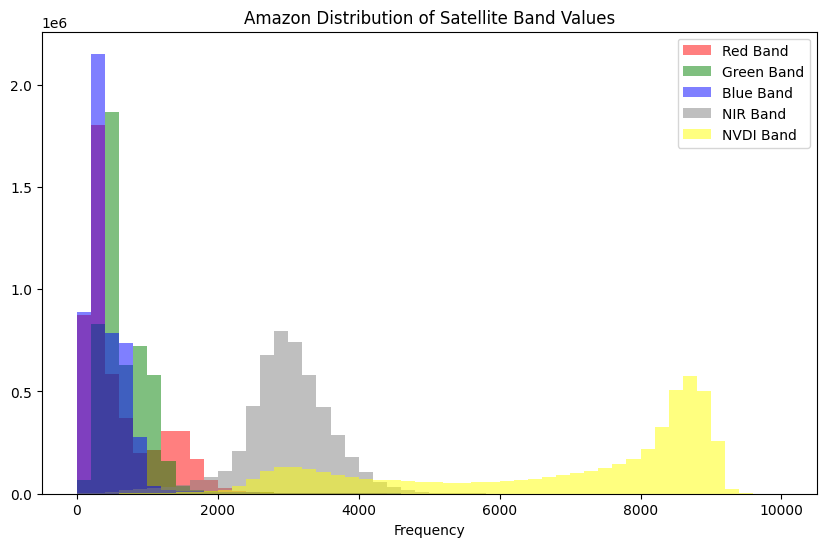

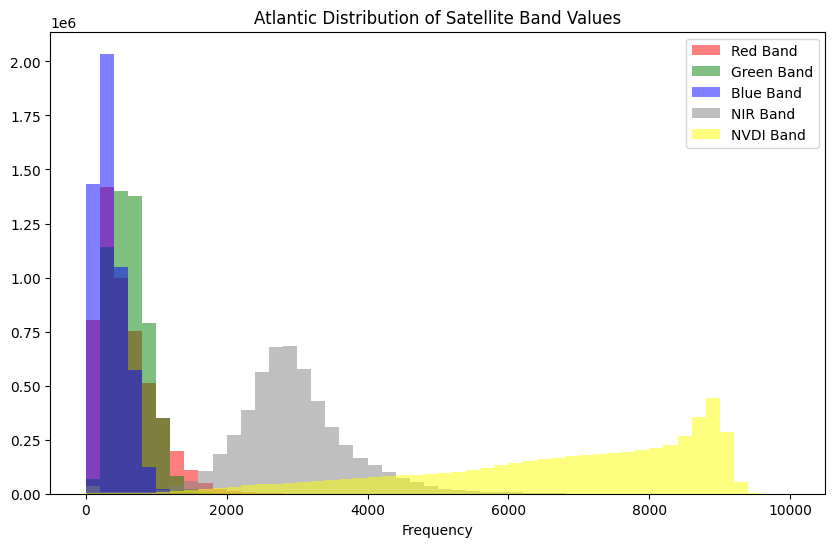

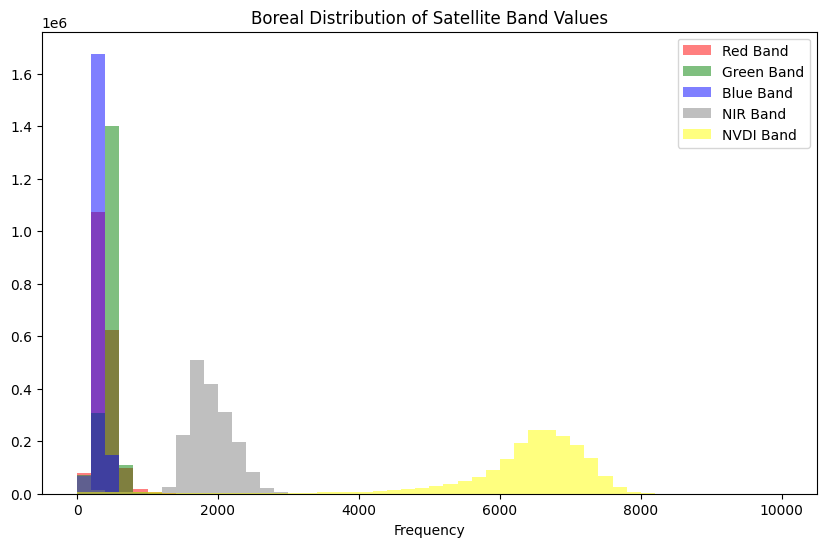

time: 6.4 s (started: 2023-07-27 20:53:00 +00:00)


In [ ]:

# for forest in forests:
#     plot_spectrum_bands( forest['data'], forest['name'] )


plot_spectrum_bands( amazon_test_data, 'Amazon' )
plot_spectrum_bands( atlantic_test_data, 'Atlantic' )
plot_spectrum_bands( boreal_data, 'Boreal' )

#Model Definition - U-Net

Define a U-Net model as a first pass.  This is a convolutional neural network.

Other models to try:


U-Net++


LinkNet


LinkNet with K-fold




In [ ]:
device = torch.device( 'cuda' if torch.cuda.is_available() else 'cpu' )
model = smp.Unet(encoder_name='timm-efficientnet-b5', encoder_depth=5, encoder_weights='imagenet', decoder_use_batchnorm=True,
                 decoder_channels=[256, 128, 64, 32, 16], decoder_attention_type='scse', in_channels=5, classes=1,
                 activation=None, aux_params=None).to(device)



time: 651 ms (started: 2023-07-27 22:17:59 +00:00)


##Loss Function

Define a loss function which is a combination of weighted binary cross entropy and Dice loss.

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CombinedLossV3(nn.Module):
    def __init__(self, weight=1.0, alpha=0.25, gamma=2., max_loss=10):
        super(CombinedLossV3, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.max_loss = max_loss
        self.beta = weight

    def forward(self, inputs, targets, smooth=1):
        # Flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)

        # Calculate weights for the BCE loss based on the targets
        beta = self.beta
        weights = beta * targets + (1 - beta) * (1 - targets)  # weights add up to 1

        # Weighted BCE Loss
        BCE = F.binary_cross_entropy_with_logits(inputs, targets, weight=weights, reduction='mean')

        # Focal Loss
        BCE_loss = F.binary_cross_entropy_with_logits(inputs, targets, reduction='none')
        pt = torch.exp(-BCE_loss) # pt is the probability of the true class
        F_loss = self.alpha * (1-pt)**self.gamma * BCE_loss
        F_loss = F_loss.clamp(max=self.max_loss)  # maintaining numerical stability
        F_loss = torch.mean(F_loss)

        # Dice Loss
        inputs_soft = torch.sigmoid(inputs)
        intersection = (inputs_soft * targets).sum()
        dice = (2.*intersection + smooth)/(inputs_soft.sum() + targets.sum() + smooth)
        dice_loss = 1 - dice

        # Combined Loss
        combined_loss = BCE + F_loss + dice_loss
        return combined_loss

time: 1.06 ms (started: 2023-07-27 22:18:02 +00:00)


##Compare data from different forests


In [ ]:

# Loading training dataset
train_data = ForestDataSet(data_type = 'train', use_default_stats = False )
train_loader = DataLoader(train_data, batch_size=6, shuffle=True)




Amazon: original pairs: 1995


<ipython-input-83-24a4f2ed6f19>:174: RuntimeWarning: invalid value encountered in true_divide
  nvdi = ( image[3] - image[0] ) / ( image[3] + image[0] )


/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20200810T133231_N0214_R081_T22JCS_20200810T155345_08_06_tile256_0_0.tif has 7 NaN values.
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20200810T133231_N0214_R081_T22JCS_20200810T155345_09_20_tile256_1_1.tif has 4 NaN values.
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2B_MSIL2A_20191129T133219_N0213_R081_T22JCS_20191129T154507_14_19_tile256_1_1.tif has 36 NaN values.
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2B_MSIL2A_20191129T133219_N0213_R081_T22JCS_20191129T154507_15_19_tile256_1_0.tif has 19 NaN values.
/content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Training/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_19_17_tile256_1_1.tif has 4 NaN values.
Atlantic: original pairs: 1940
Total: original pairs: 3935
Mean: {'red': 0.058092367, 'green'

In [ ]:
# Loading validation dataset
valid_data = ForestDataSet(data_type = "val")
valid_loader = DataLoader(valid_data, batch_size=6, shuffle=True)

Mask sum <= 0 
Mask sum <= 0 
Mask sum <= 0 
Mask sum <= 0 
Amazon: original pairs: 400
Atlantic: original pairs: 400
Total: original pairs: 800
Mean: {'red': 0.057409223, 'green': 0.06472079, 'blue': 0.038716096, 'nir': 0.29959354, 'nvdi': 0.6768831}
Std Dev: {'red': 0.045892097, 'green': 0.031139867, 'blue': 0.027061649, 'nir': 0.07877214, 'nvdi': 0.23522303}
Using 796/800 data files.
self.mean: [0.05809237 0.06499667 0.03907543 0.2980774  0.67502433]
self.SD: [0.04656493 0.03191178 0.0280921  0.07890162 0.23065257]
time: 6.41 s (started: 2023-07-27 22:14:24 +00:00)


In [ ]:
# Loading test dataset
test_data = ForestDataSet(data_type = "test")
test_loader = DataLoader(test_data, batch_size=6, shuffle=True)

Mask sum <= 0 
Mask sum <= 0 
Mask sum <= 0 
Mask sum <= 0 
Amazon: original pairs: 80
Atlantic: original pairs: 80
Total: original pairs: 160
Mean: {'red': 0.059333332, 'green': 0.065356754, 'blue': 0.03924171, 'nir': 0.29549998, 'nvdi': 0.6755357}
Std Dev: {'red': 0.048193246, 'green': 0.03411743, 'blue': 0.030785592, 'nir': 0.07344424, 'nvdi': 0.21968704}
Using 156/160 data files.
self.mean: [0.05809237 0.06499667 0.03907543 0.2980774  0.67502433]
self.SD: [0.04656493 0.03191178 0.0280921  0.07890162 0.23065257]
time: 1.06 s (started: 2023-07-27 22:14:32 +00:00)


In [ ]:

# Loading boreal forest of Ontario dataset
boreal_data = ForestDataSet(data_type = 'none', forest='boreal')
boreal_loader = DataLoader(boreal_data, batch_size=1, shuffle=True)

/content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_caribou-lake-702_1.tif has 1024 NaN values.
/content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_caribou-lake-702_1.tif has 256 NaN values.
Boreal Forest n_pairs: 29
Mean: {'red': 0.039536912, 'green': 0.0460016, 'blue': 0.031633206, 'nir': 0.18118046, 'nvdi': 0.6191482}
Std Dev: {'red': 0.013311036, 'green': 0.01068894, 'blue': 0.0072314423, 'nir': 0.047421798, 'nvdi': 0.14689377}
Using 29/29 data files.
self.mean: [0.05809237 0.06499667 0.03907543 0.2980774  0.67502433]
self.SD: [0.04656493 0.03191178 0.0280921  0.07890162 0.23065257]
time: 250 ms (started: 2023-07-27 22:14:37 +00:00)


<ipython-input-83-24a4f2ed6f19>:174: RuntimeWarning: invalid value encountered in true_divide
  nvdi = ( image[3] - image[0] ) / ( image[3] + image[0] )


##Training Setup

In [ ]:
epochs = 200
total_steps = len(train_loader)
n_warmup_epochs = 20

# Define the loss function and optimizer
criterion = CombinedLossV3(train_data.pos_weight)
optimizer = AdamW(model.parameters(), lr=0.001, weight_decay=0.1)

scheduler = CosineLRScheduler(
            optimizer,
            t_initial= total_steps * epochs + 1,
            lr_min=0.0001,
            warmup_lr_init=0.0001,
            warmup_t= total_steps * n_warmup_epochs + 1)

time: 4.24 ms (started: 2023-07-27 22:18:08 +00:00)


##Training Loop

In [ ]:
def dice_coeff(pred, target, smooth=1):
    pred = pred.contiguous()
    target = target.contiguous()

    intersection = (pred * target).sum(dim=2).sum(dim=2)

    dice = (2. * intersection + smooth) / (pred.sum(dim=2).sum(dim=2) + target.sum(dim=2).sum(dim=2) + smooth)

    return dice.mean()

def iou(pred, target, smooth=1):
    pred = pred.contiguous()
    target = target.contiguous()

    intersection = (pred * target).sum(dim=2).sum(dim=2)
    total = (pred + target).sum(dim=2).sum(dim=2)

    iou = (intersection + smooth) / (total - intersection + smooth)

    return iou.mean()

time: 954 µs (started: 2023-07-27 22:18:10 +00:00)


In [ ]:
class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""
    def __init__(self, patience=7, verbose=False, delta=0):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
                            Default: 7
            verbose (bool): If True, prints a message for each validation loss improvement.
                            Default: False
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
                            Default: 0
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = float('inf')
        self.delta = delta
        self.best_pt = ''

    def __call__(self, val_loss, model, pt_path):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model, pt_path)
        elif score < self.best_score + self.delta:
            self.counter += 1
            print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model, pt_path)
            self.counter = 0

    def save_checkpoint(self, val_loss, model, pt_path):
        '''Saves model when validation loss decreases.'''
        if self.verbose:
            print(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model, pt_path)  # save checkpoint
        self.val_loss_min = val_loss
        self.best_pt = pt_path

time: 851 µs (started: 2023-07-27 22:18:12 +00:00)


In [ ]:
early_stopping = EarlyStopping(patience=12, verbose=True)

def binarize_output(output, threshold=0.5):
    return (output > threshold).float()

def train_model(model_path, model, optimizer, scheduler, num_epochs):
  !rm -rf {model_path}
  !mkdir -p {model_path}
  step_counter_train, step_counter_val = 0, 0
  since = time.time()
  iteration = 0
  best_f1 = 0.0

  for epoch in range(num_epochs):
      print('Epoch {}/{}'.format(epoch+1, num_epochs))
      model.train()
      total_loss, total_dice, total_iou = 0.0, 0.0, 0.0
      for step, batch in enumerate(train_loader):
          x = batch[0].to(device)
          y = batch[1].to(device)

          optimizer.zero_grad()
          outputs = model(x)
          # Partial loss against original labels, partial loss against mixed up labels
          loss = criterion(outputs, y)

          loss.backward()
          optimizer.step()
          scheduler.step(iteration)
          iteration += 1

          # Calculate metrics.
          outputs_prob = torch.sigmoid(outputs)
          train_iou = iou(outputs_prob, y).item()
          train_dice = dice_coeff(outputs_prob, y).item()
          train_loss = loss.item()
          total_loss += train_loss
          total_dice += train_dice
          total_iou += train_iou

          writer.add_scalar('Loss/Train', train_loss, step_counter_train)
          writer.add_scalar('IoU/Train', train_iou, step_counter_train)
          writer.add_scalar('Dice/Train', train_dice, step_counter_train)
          step_counter_train += 1
          # Log the images
          if step % 20 == 0:  # Only log every 10 batches
              original_grid = make_grid(batch[2][0][:3,:,:])
              input_grid = batch[0][0]
              for i in range(input_grid.shape[0]):
                  input_grid[i] = (input_grid[i] - input_grid[i].min()) / (input_grid[i].max() - input_grid[i].min())
              input_grid = make_grid(input_grid[:3, :, :])
              output_grid = make_grid(binarize_output(outputs.detach()[0]))
              label_grid = make_grid(batch[1][0])
              writer.add_image('Input/Train', input_grid, epoch * len(train_loader) + step)
              writer.add_image('Output/Train', output_grid, epoch * len(train_loader) + step)
              writer.add_image('Label/Train', label_grid, epoch * len(train_loader) + step)
              writer.add_image('Original/Train', original_grid, epoch * len(train_loader) + step)
      avg_loss = total_loss / len(train_loader)
      avg_dice = total_dice / len(train_loader)
      avg_iou = total_iou / len(train_loader)
      writer.add_scalar('Epoch_Loss/Train', avg_loss, epoch)
      writer.add_scalar('Epoch_IoU/Train', avg_iou, epoch)
      writer.add_scalar('Epoch_Dice/Train', avg_dice, epoch)

      model.eval()
      total_loss, total_dice, total_iou = 0.0, 0.0, 0.0
      for step, batch in enumerate(valid_loader):
          x = batch[0].to(device)
          y = batch[1].to(device)
          with torch.no_grad():
              outputs = model(x)
              loss = criterion(outputs, y)

          # Calculate metrics.
          outputs_prob = torch.sigmoid(outputs)
          val_iou = iou(outputs_prob, y).item()
          val_dice = dice_coeff(outputs_prob, y).item()
          val_loss = loss.item()
          total_loss += val_loss
          total_dice += val_dice
          total_iou += val_iou

          writer.add_scalar('Loss/Validate', val_loss, step_counter_val)
          writer.add_scalar('IoU/Validate', val_iou, step_counter_val)
          writer.add_scalar('Dice/Validate', val_dice, step_counter_val)
          step_counter_val += 1

          # Log the images
          if step % 5 == 0:  # Only log every 10 batches
              original_grid = make_grid(batch[2][0][:3,:,:])
              input_grid = batch[0][0]
              for i in range(input_grid.shape[0]):
                  input_grid[i] = (input_grid[i] - input_grid[i].min()) / (input_grid[i].max() - input_grid[i].min())
              input_grid = make_grid(input_grid[:3, :, :])
              output_grid = make_grid(binarize_output(outputs.detach()[0]))
              label_grid = make_grid(batch[1][0])
              writer.add_image('Input/Validate', input_grid, epoch * len(valid_loader) + step)
              writer.add_image('Output/Validate', output_grid, epoch * len(valid_loader) + step)
              writer.add_image('Label/Validate', label_grid, epoch * len(valid_loader) + step)
              writer.add_image('Original/Validate', original_grid, epoch * len(valid_loader) + step)
      avg_loss = total_loss / len(valid_loader)
      avg_dice = total_dice / len(valid_loader)
      avg_iou = total_iou / len(valid_loader)
      writer.add_scalar('Epoch_Loss/Validate', avg_loss, epoch)
      writer.add_scalar('Epoch_IoU/Validate', avg_iou, epoch)
      writer.add_scalar('Epoch_Dice/Validate', avg_dice, epoch)
      print(f"Avg Loss = {avg_loss:.5f}, Avg IoU = {avg_iou:.5f}, Avg Dice = {avg_dice:.5F}")

      # Early_stopping needs the validation loss to check if it has decreased,
      # and if it has, it will save the current model checkpoint
      pt_path = model_path+f"model_epoch_{epoch}_dice_{avg_dice:.5f}_iou_{avg_iou:.5f}.pt"
      early_stopping(avg_loss, model, pt_path)

      if early_stopping.early_stop:
          print("Early stopping")
          break

time: 2.47 ms (started: 2023-07-27 22:18:16 +00:00)


In [ ]:

# Load the TensorBoard notebook extension
%load_ext tensorboard

%tensorboard --logdir=/data/runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 49037), started 0:04:12 ago. (Use '!kill 49037' to kill it.)

<IPython.core.display.Javascript object>

time: 8.86 ms (started: 2023-07-27 22:15:10 +00:00)


## Train Model
## Store Trained Model to Google Drive

In [ ]:
model_path = "/content/drive/MyDrive/content/drive/GreenGuardians/models/forest/unet/"




time: 367 µs (started: 2023-07-27 22:15:20 +00:00)


In [ ]:
train_model(model_path, model, optimizer, scheduler, epochs)

Epoch 1/200
Avg Loss = 0.13550, Avg IoU = 0.76209, Avg Dice = 0.85221
Validation loss decreased (inf --> 0.135499).  Saving model ...
Epoch 2/200
Avg Loss = 0.11092, Avg IoU = 0.81440, Avg Dice = 0.88962
Validation loss decreased (0.135499 --> 0.110921).  Saving model ...
Epoch 3/200
Avg Loss = 0.09835, Avg IoU = 0.83455, Avg Dice = 0.90337
Validation loss decreased (0.110921 --> 0.098348).  Saving model ...
Epoch 4/200
Avg Loss = 0.09625, Avg IoU = 0.83194, Avg Dice = 0.89969
Validation loss decreased (0.098348 --> 0.096254).  Saving model ...
Epoch 5/200
Avg Loss = 0.08883, Avg IoU = 0.84218, Avg Dice = 0.90816
Validation loss decreased (0.096254 --> 0.088831).  Saving model ...
Epoch 6/200
Avg Loss = 0.08390, Avg IoU = 0.85743, Avg Dice = 0.91775
Validation loss decreased (0.088831 --> 0.083903).  Saving model ...
Epoch 7/200
Avg Loss = 0.08739, Avg IoU = 0.84124, Avg Dice = 0.90655
EarlyStopping counter: 1 out of 12
Epoch 8/200
Avg Loss = 0.07987, Avg IoU = 0.85620, Avg Dice = 0.91

In [ ]:
print( early_stopping.best_pt)

/content/drive/MyDrive/content/drive/GreenGuardians/models/forest/unet/model_epoch_24_dice_0.93295_iou_0.88223.pt
time: 691 µs (started: 2023-07-27 23:26:28 +00:00)


##Model Output

With Validation Data.

In [ ]:
def eval_model_with_dataset( model, dataset, dataset_loader ):

    trans = None

    t_data = dataset
    t_loader = dataset_loader


    model.eval()
    total_loss, total_dice, total_iou = 0.0, 0.0, 0.0
    for i, (images, target, _, i_f, m_f) in enumerate(t_loader):

        images = images.to(device)
        label_mask = target.numpy()[0][0]
        label_mask = label_mask.astype('float32')

        f = i_f[0]
        print("f:", f)

        with torch.no_grad():
            outputs = model(images)

        predict_mask = outputs[0][0]
        predict_mask = torch.sigmoid(predict_mask)
        predict_mask = torch.round(predict_mask)
        predict_mask = predict_mask.cpu().detach().numpy()


        fig, ax = plt.subplots(2, 3, figsize=(18, 12))
        img, xsize, ysize, nbands = loadTIFF(f, 10000)
        img_rgb = np.dstack((img[:,:,0], img[:,:,1], img[:,:,2])).astype(np.float32)
        img_rgb = np.clip( img_rgb/2000, 0, 1)


        # # Create a red color overlay using the predict mask for deforestation
        # invert the mask as it predicts forestation.

        deforest_predict_mask = np.logical_not(predict_mask).astype(int)
        deforest_predict_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
        deforest_predict_overlay[..., 0] = 1 # Red channel ( since it is showing deforested  )
        deforest_predict_overlay[..., 3] = deforest_predict_mask


        # # Create a red color overlay using the labeled mask
        deforest_label_mask = np.logical_not(label_mask).astype(int)
        deforest_label_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
        deforest_label_overlay[..., 0] = 1  # Red channel ( since it is showing deforested  )l
        deforest_label_overlay[..., 3] = deforest_label_mask

        # Display the original image and the ground truth masked image
        ax[0,0].imshow(img_rgb)
        ax[0,0].set_title('Original Image')
        ax[0,0].axis('off')

        ax[0,1].imshow(img_rgb)
        ax[0,1].imshow(deforest_label_overlay)
        ax[0,1].set_title('Truth Mask')
        ax[0,1].axis('off')

        ax[0,2].imshow(deforest_label_mask, cmap='gray')
        ax[0,2].set_title('Truth Mask')
        ax[0,2].axis('off')

        # Display the original image and the predicted masked image
        ax[1,0].imshow(img_rgb)
        ax[1,0].set_title('Original Image')
        ax[1,0].axis('off')

        ax[1,1].imshow(img_rgb)
        ax[1,1].imshow(deforest_predict_overlay)
        ax[1,1].set_title('Predicted Mask')
        ax[1,1].axis('off')

        ax[1,2].imshow(deforest_predict_mask, cmap='gray')
        ax[1,2].set_title('Predicted Mask')
        ax[1,2].axis('off')

        plt.show()


time: 1.78 ms (started: 2023-07-27 23:26:34 +00:00)


## If you have a validly trained model to use, load that from Google Drive rather than re-training

In [ ]:
# import glob
# import os

# list_of_files = glob.glob(model_path + '*') # * means all if need specific format then *.csv
# newest_model_checkpoint = max(list_of_files, key=os.path.getctime)
# print("Newest Model Checkpoint:", newest_model_checkpoint)

# # initialize model again
# device = torch.device( 'cuda' if torch.cuda.is_available() else 'cpu' )

# # load state from latest checkpoint
# model = torch.load(newest_model_checkpoint)



Newest Model Checkpoint: /content/drive/MyDrive/content/drive/GreenGuardians/models/forest/unet/model_epoch_29_dice_0.93881_iou_0.89038.pt
time: 614 ms (started: 2023-07-18 16:05:55 +00:00)


## Load Test Data Set

In [ ]:
# Loading validation dataset
test_data = ForestDataSet(data_type = "test")
test_loader = DataLoader(test_data, batch_size=6, shuffle=True)

Mask sum <= 0 
Mask sum <= 0 
Mask sum <= 0 
Mask sum <= 0 
Amazon: original pairs: 80
Atlantic: original pairs: 80
Total: original pairs: 160
Mean: {'red': 0.059333332, 'green': 0.065356754, 'blue': 0.03924171, 'nir': 0.29549998}
Std Dev: {'red': 0.048193246, 'green': 0.03411743, 'blue': 0.030785592, 'nir': 0.07344424}
Using 156/160 data files.
time: 958 ms (started: 2023-07-18 23:34:14 +00:00)


## Evaluate Model on Test Data

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_15_08_tile256_1_0.tif


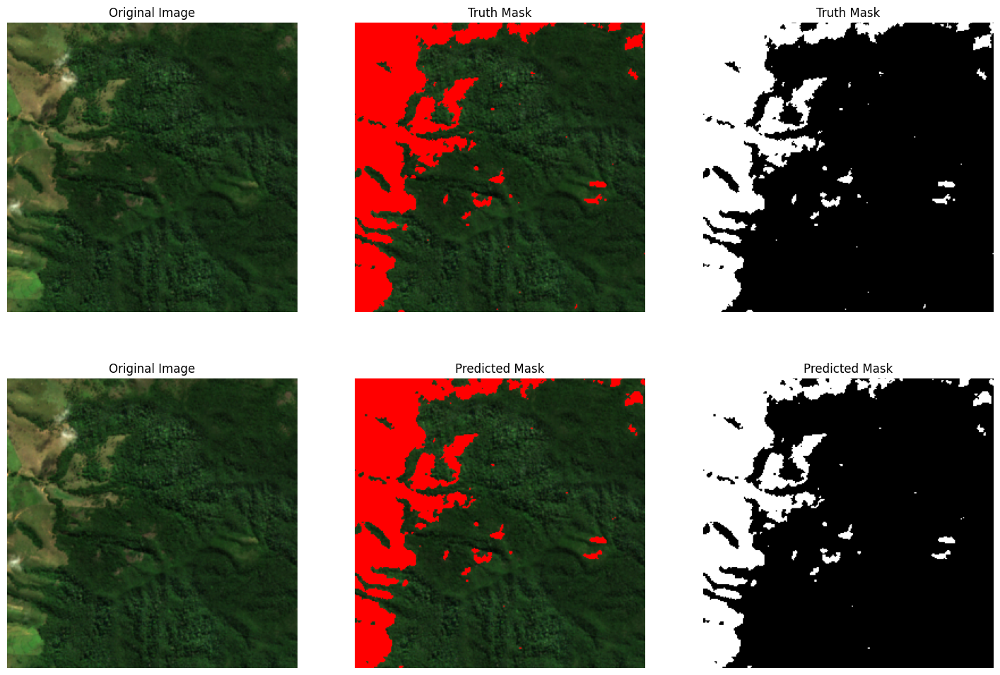

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_08_08_tile256_1_1.tif


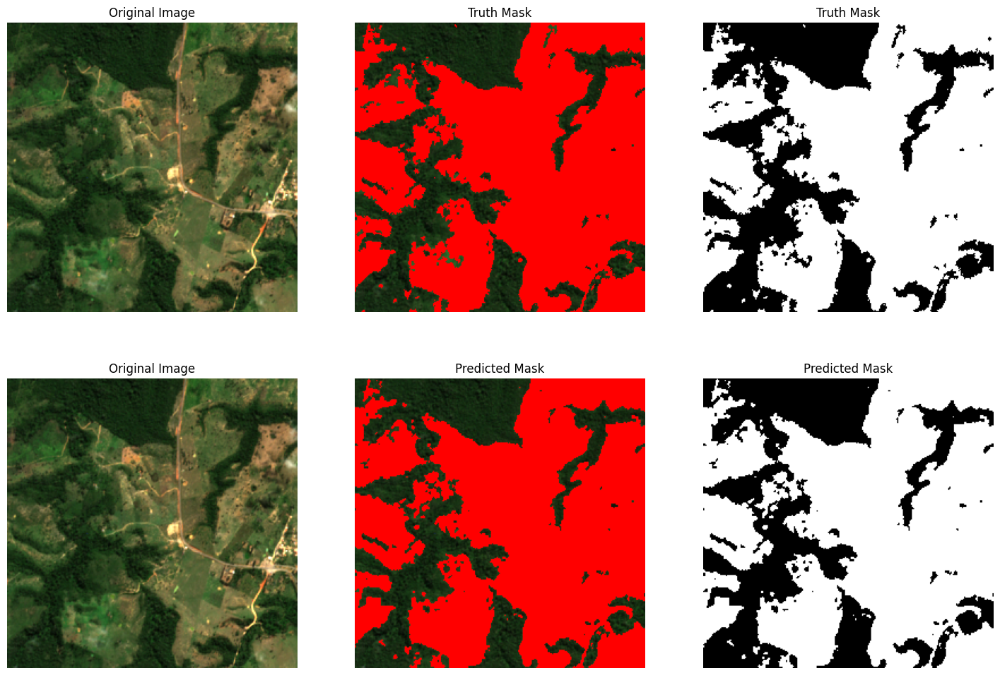

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20200612T130251_N0214_R095_T23KQV_20200612T165421_16_01_tile256_0_0.tif


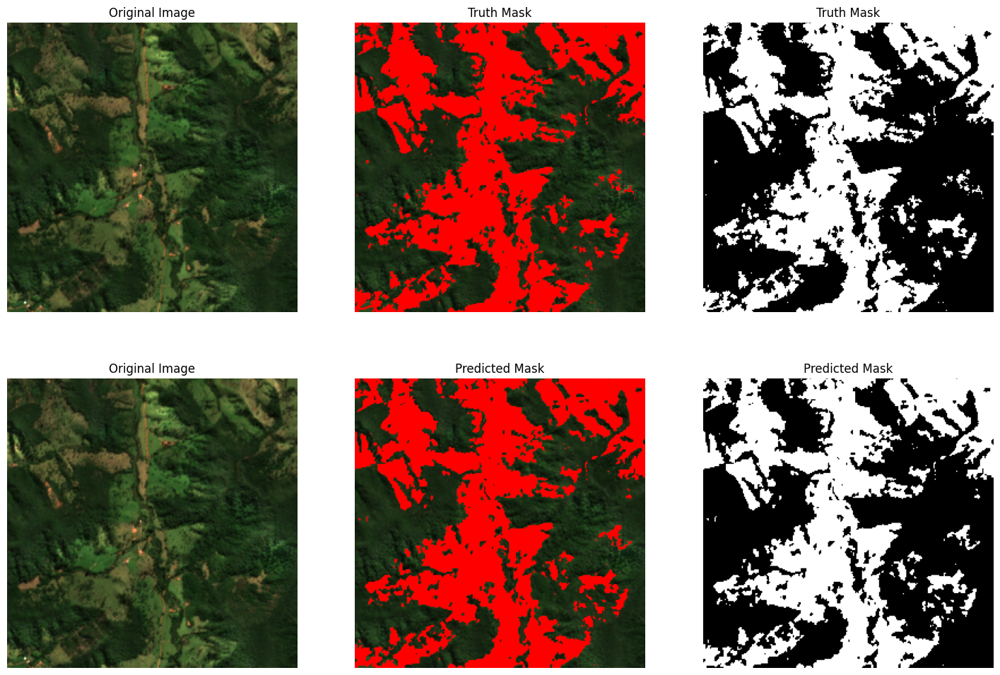

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200818T142741_N0214_R053_T20LMP_20200818T165705_03_18_tile256_0_1.tif


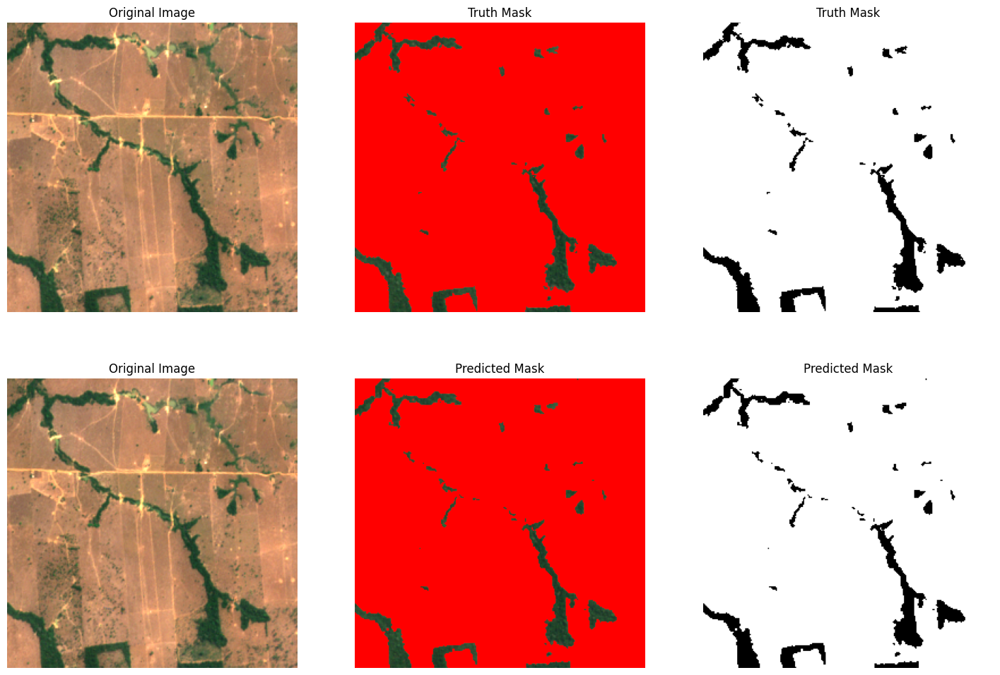

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200217T141651_N0209_R010_T20LQN_20200217T160045_13_19_tile256_1_1.tif


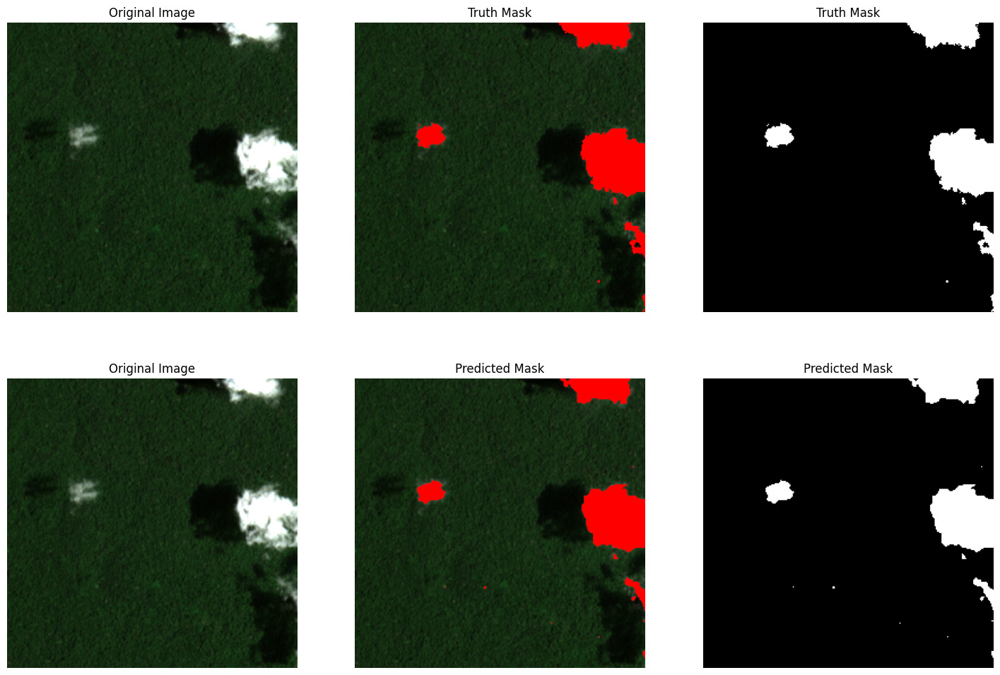

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_16_11_tile256_1_1.tif


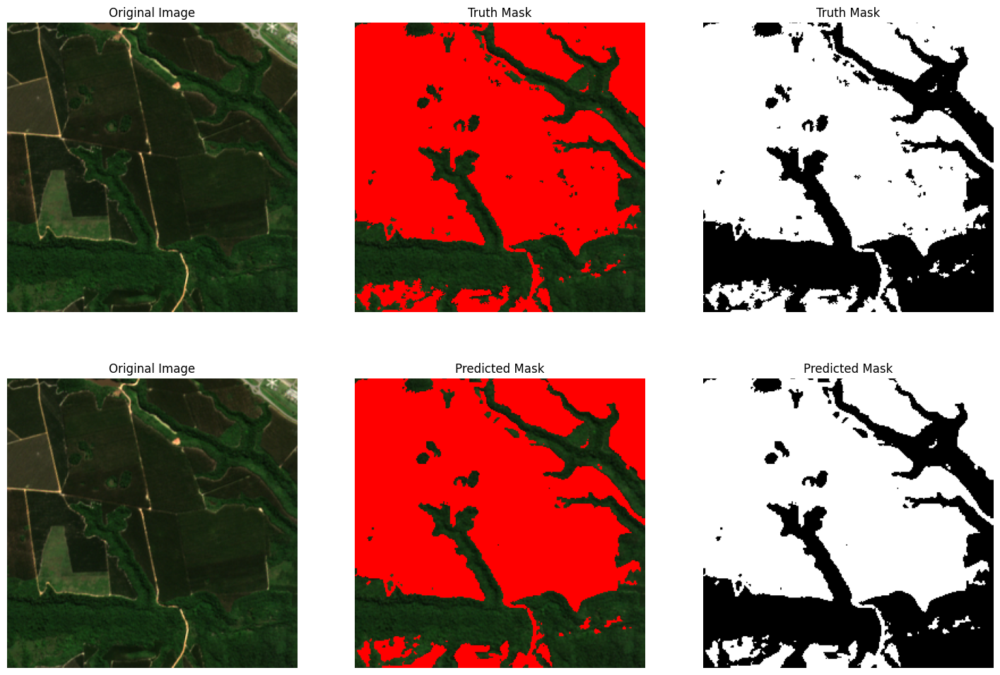

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200217T141651_N0209_R010_T20LQN_20200217T160045_18_03_tile256_1_0.tif


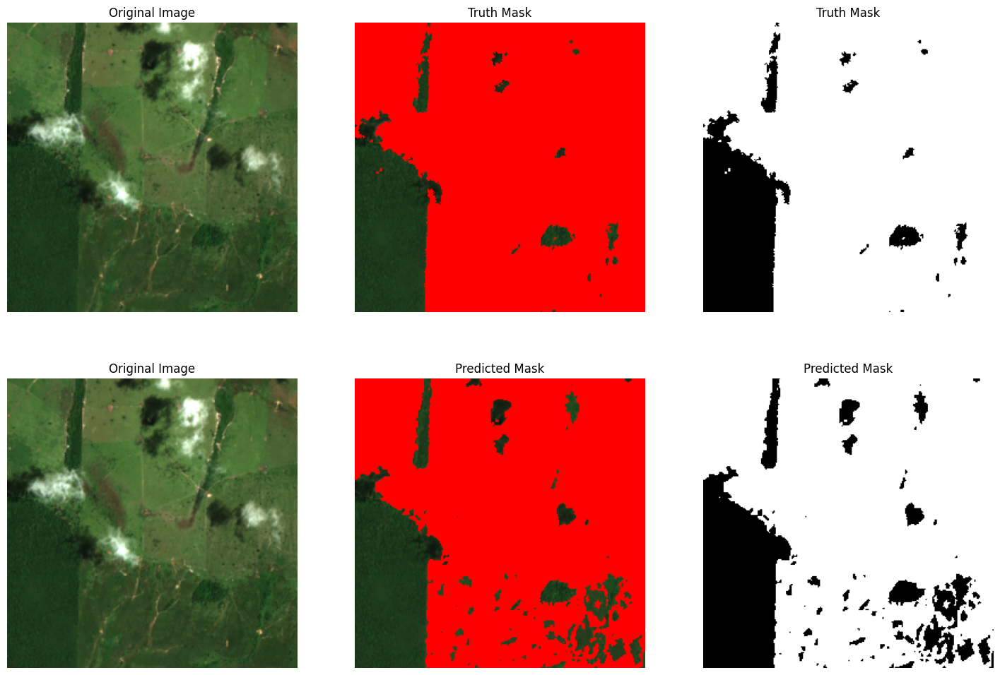

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20200612T130251_N0214_R095_T23KQV_20200612T165421_16_01_tile256_0_1.tif


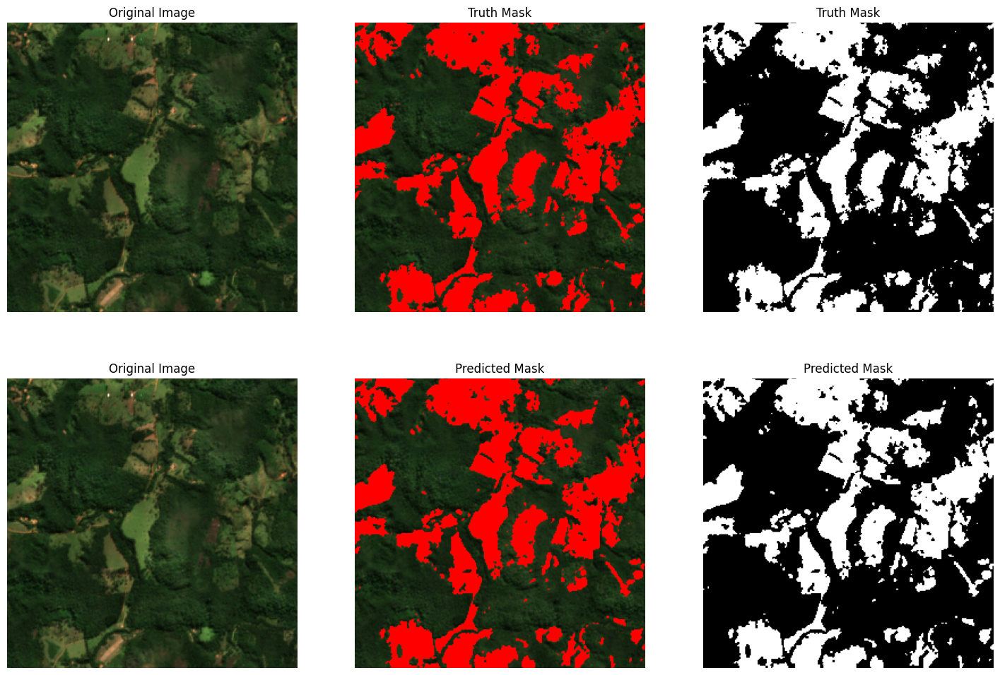

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2B_MSIL2A_20200202T141649_N0213_R010_T20LQN_20200202T164215_02_08_tile256_0_0.tif


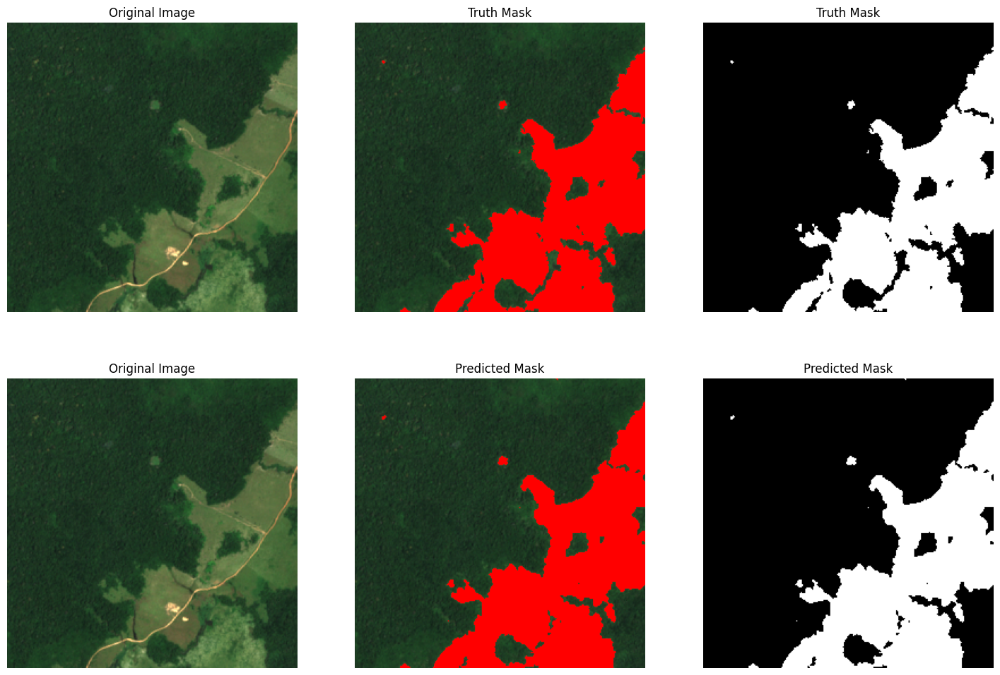

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200818T142741_N0214_R053_T20LMP_20200818T165705_08_06_tile256_1_0.tif


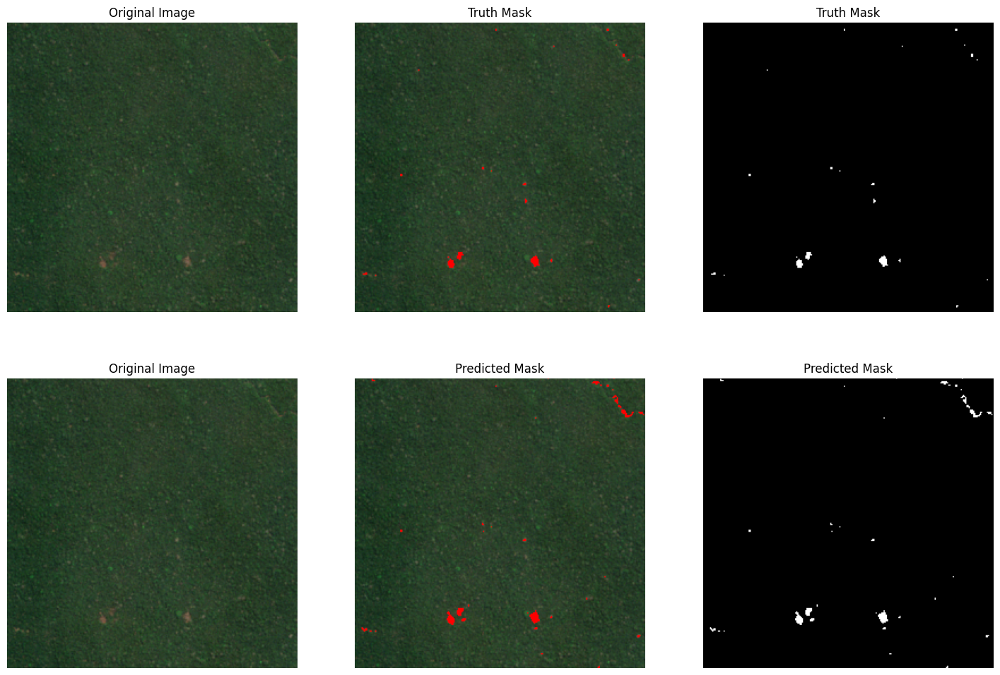

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2B_MSIL2A_20191129T133219_N0213_R081_T22JCS_20191129T154507_08_17_tile256_1_1.tif


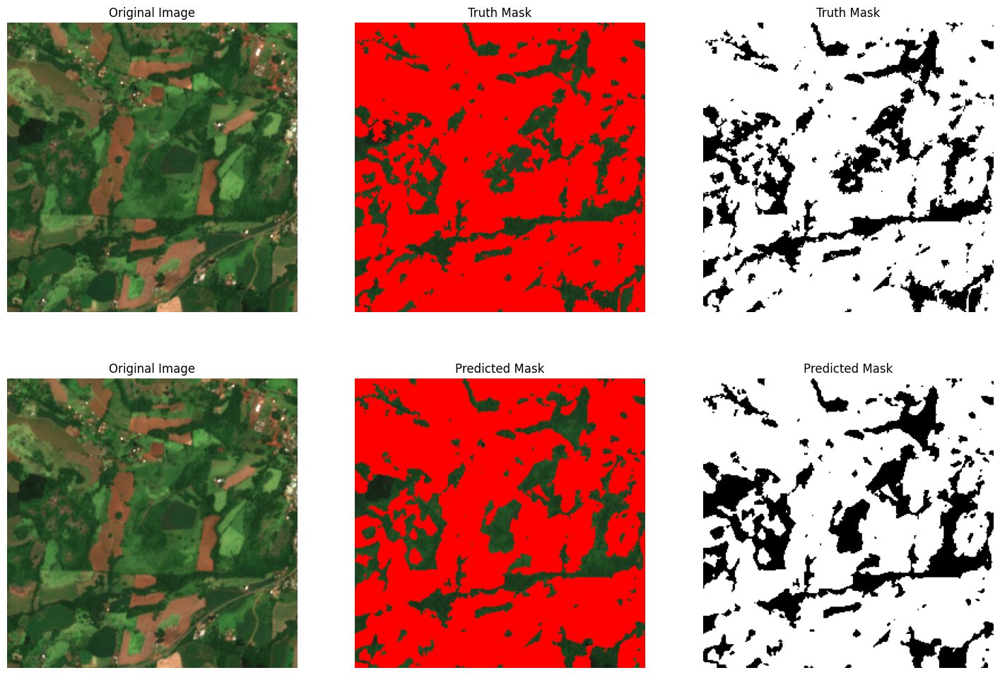

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_01_06_tile256_0_1.tif


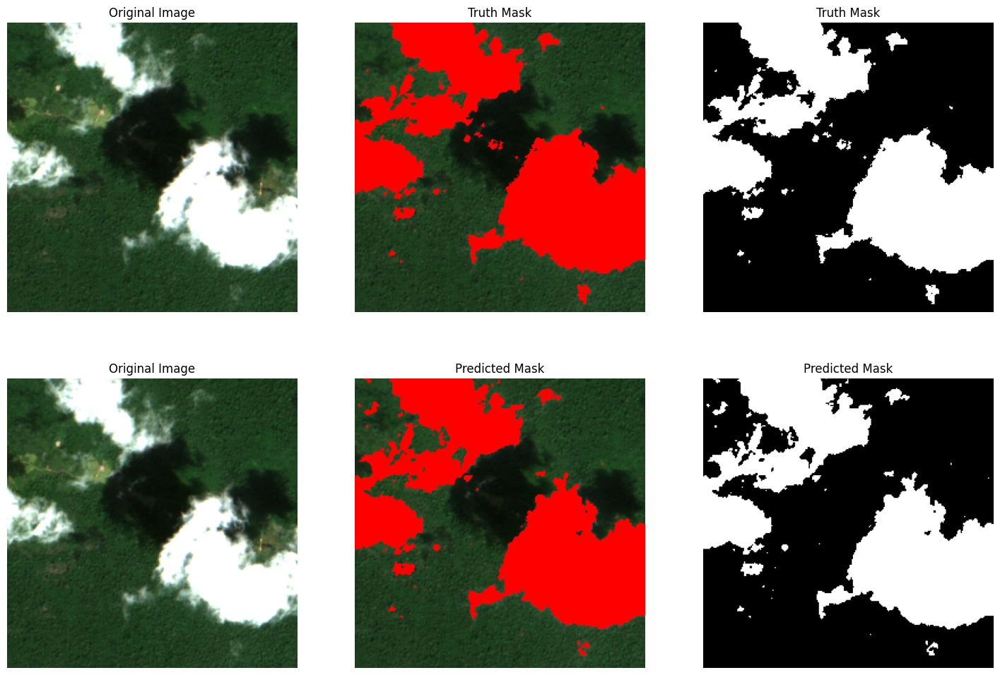

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2B_MSIL2A_20200202T141649_N0213_R010_T20LQN_20200202T164215_02_08_tile256_1_0.tif


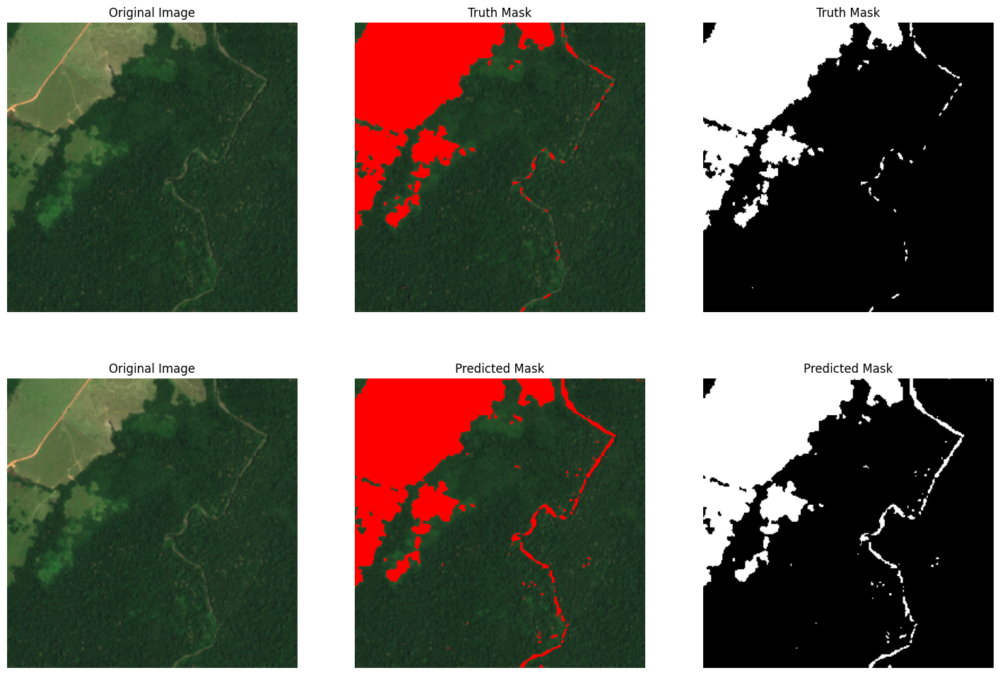

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200217T141651_N0209_R010_T20LQN_20200217T160045_13_19_tile256_0_0.tif


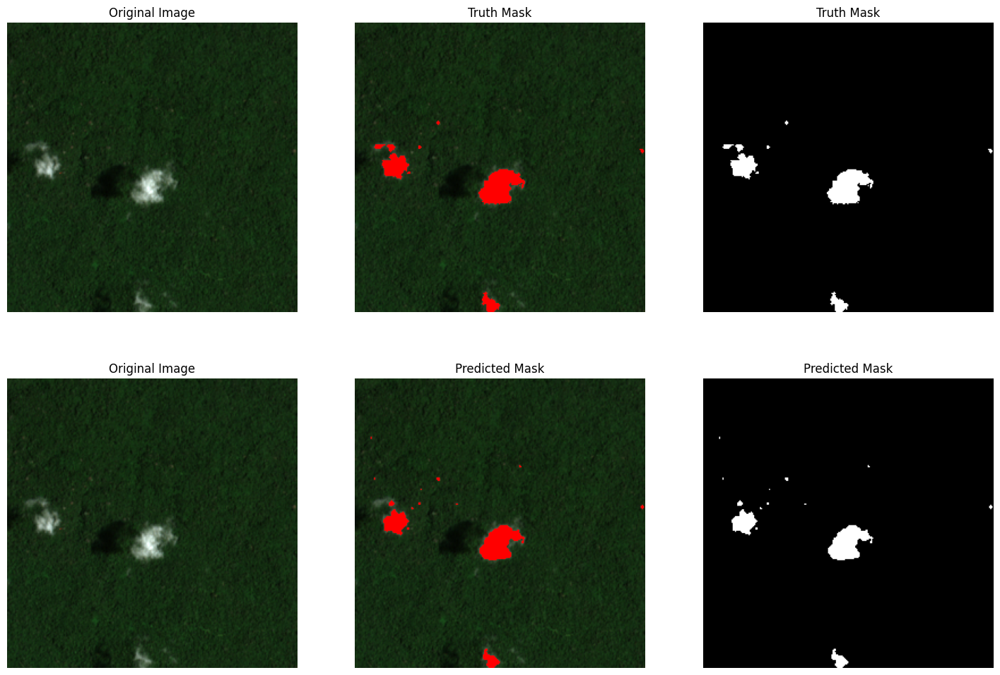

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200818T142741_N0214_R053_T20LMP_20200818T165705_11_20_tile256_1_1.tif


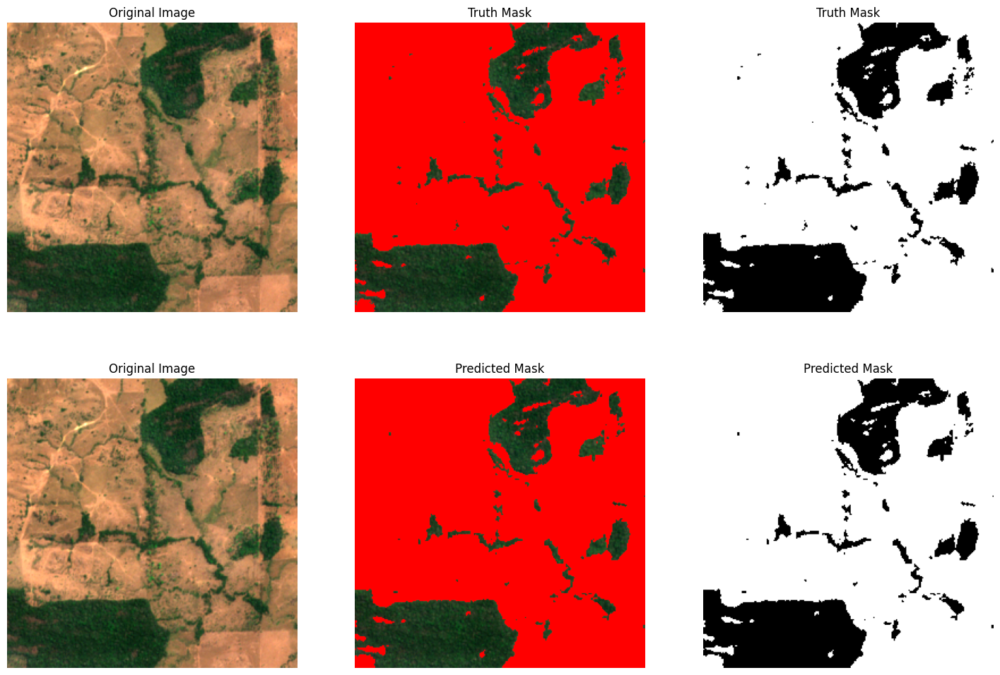

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200111T142701_N0213_R053_T20NQG_20200111T164651_04_19_tile256_1_1.tif


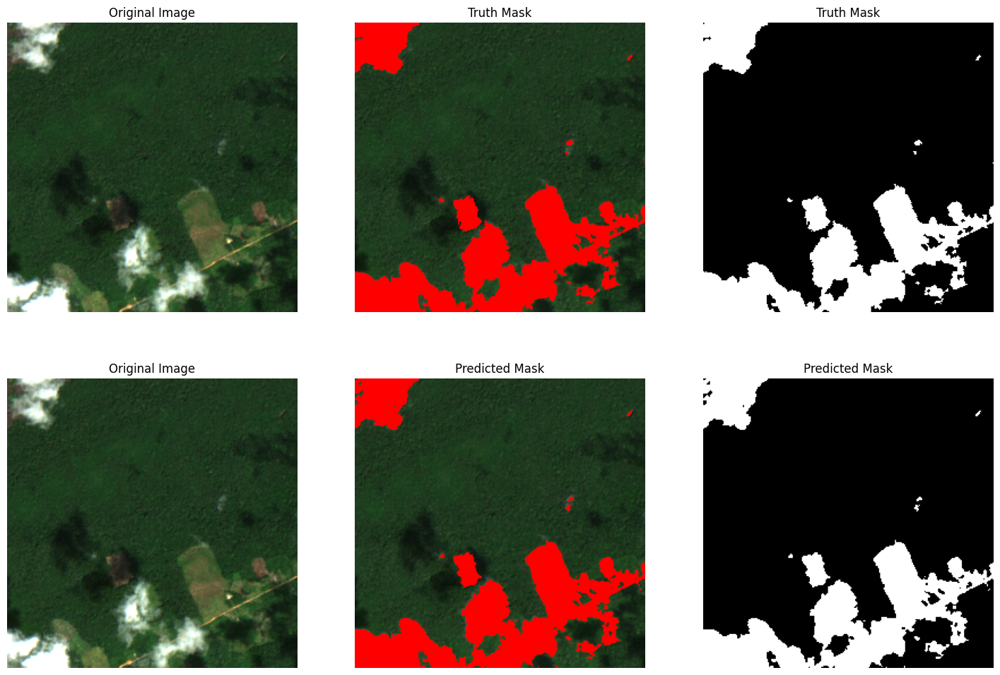

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20191105T130251_N0213_R095_T23KQV_20191105T150708_14_07_tile256_1_1.tif


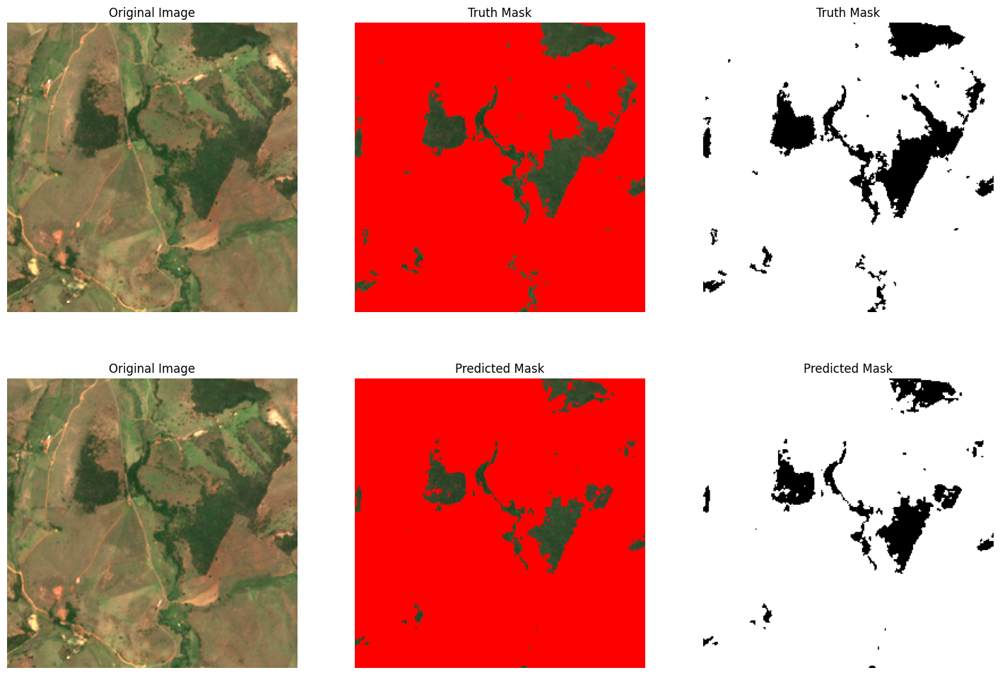

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200217T141651_N0209_R010_T20LQN_20200217T160045_19_04_tile256_0_1.tif


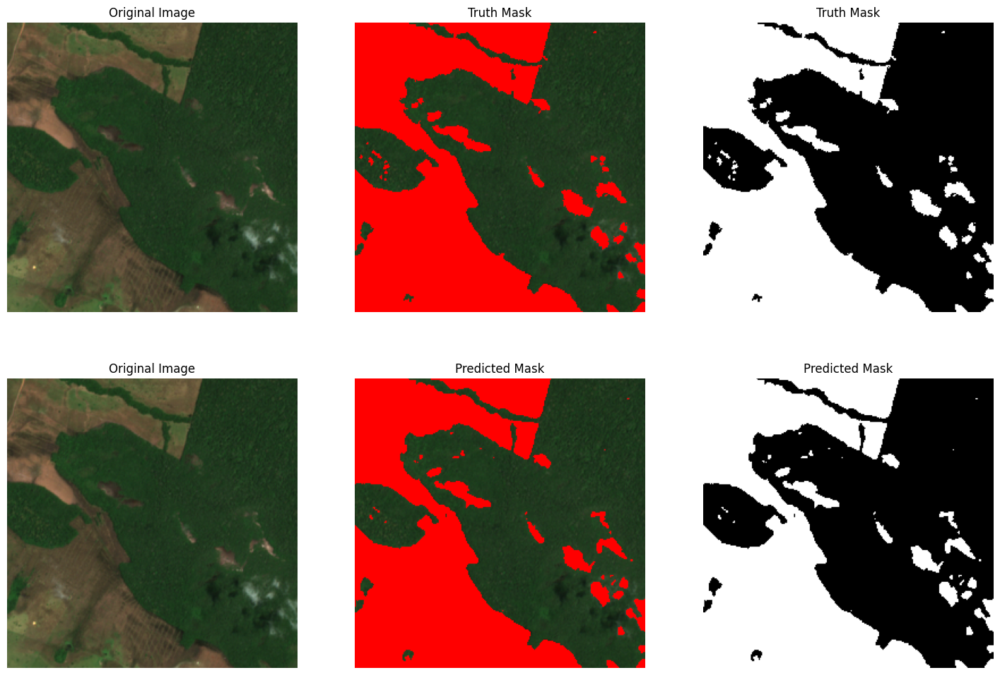

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20191105T130251_N0213_R095_T23KQV_20191105T150708_18_02_tile256_0_0.tif


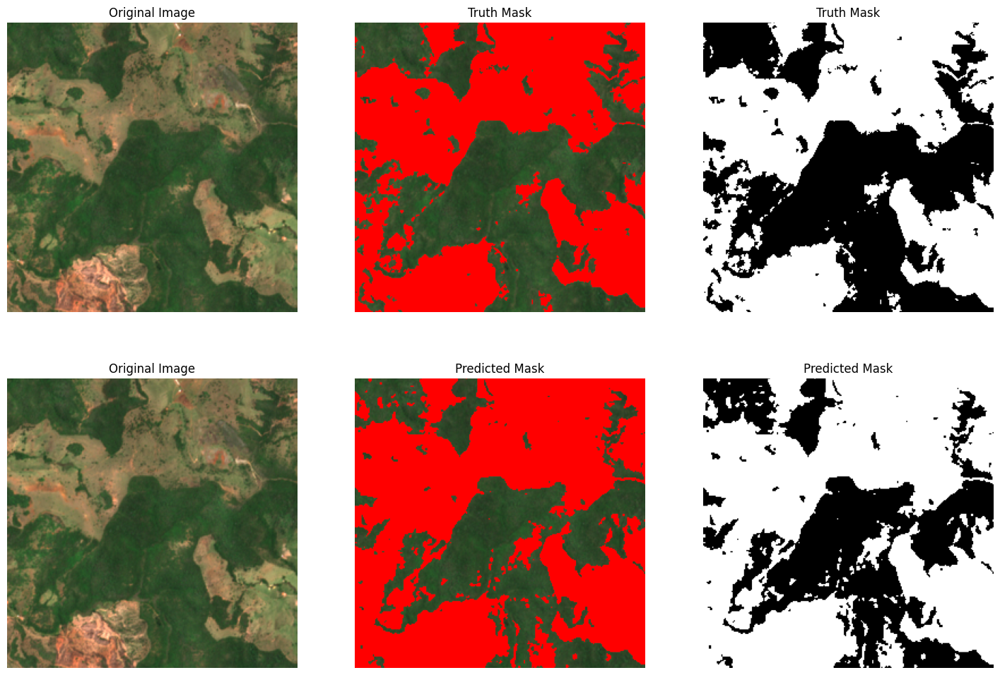

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2B_MSIL2A_20191129T133219_N0213_R081_T22JCS_20191129T154507_08_17_tile256_0_1.tif


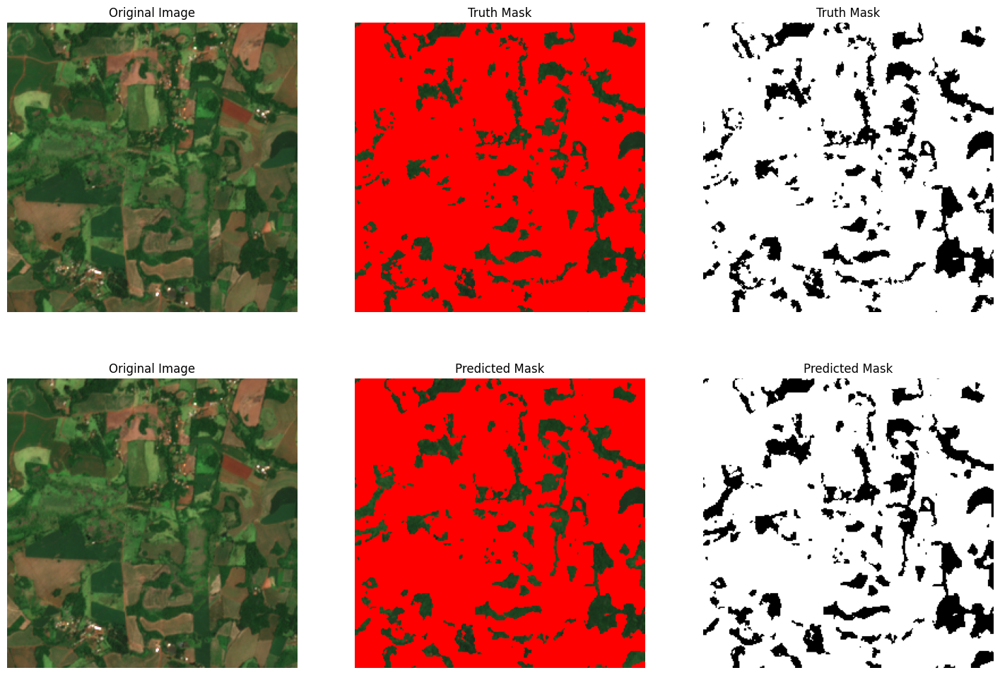

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200217T141651_N0209_R010_T20LQN_20200217T160045_13_19_tile256_1_0.tif


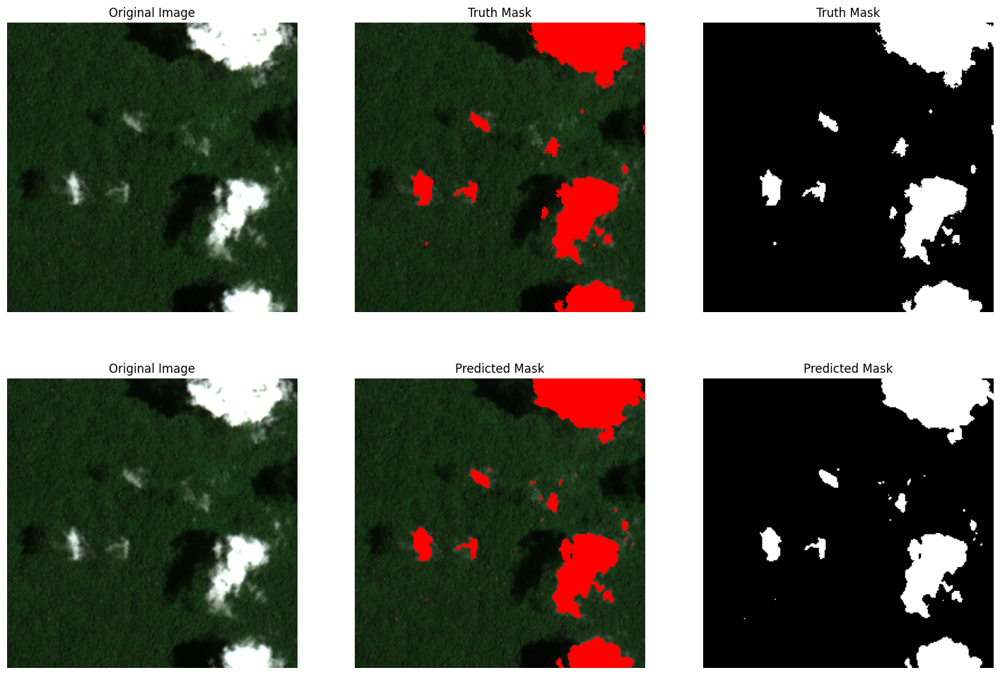

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200818T142741_N0214_R053_T20LMP_20200818T165705_03_18_tile256_0_0.tif


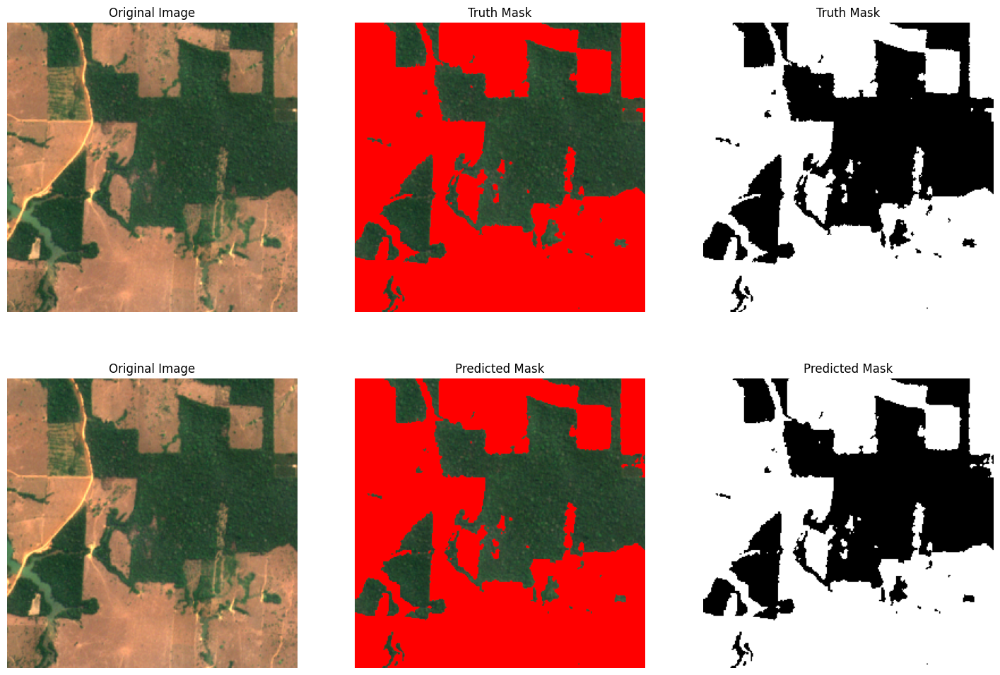

f: /content/drive/MyDrive/content/drive/GreenGuardians/ATLANTIC256/Test/images/S2A_MSIL2A_20190715T125311_N0213_R052_T24LVH_20190715T150206_20_15_tile256_0_0.tif


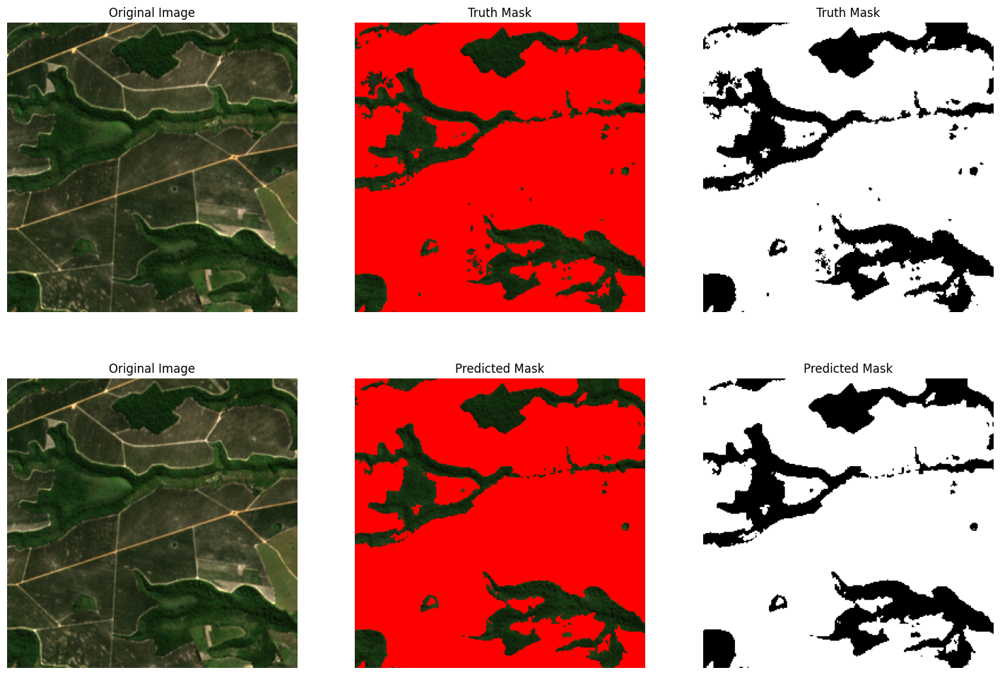

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200217T141651_N0209_R010_T20LQN_20200217T160045_01_20_tile256_0_1.tif


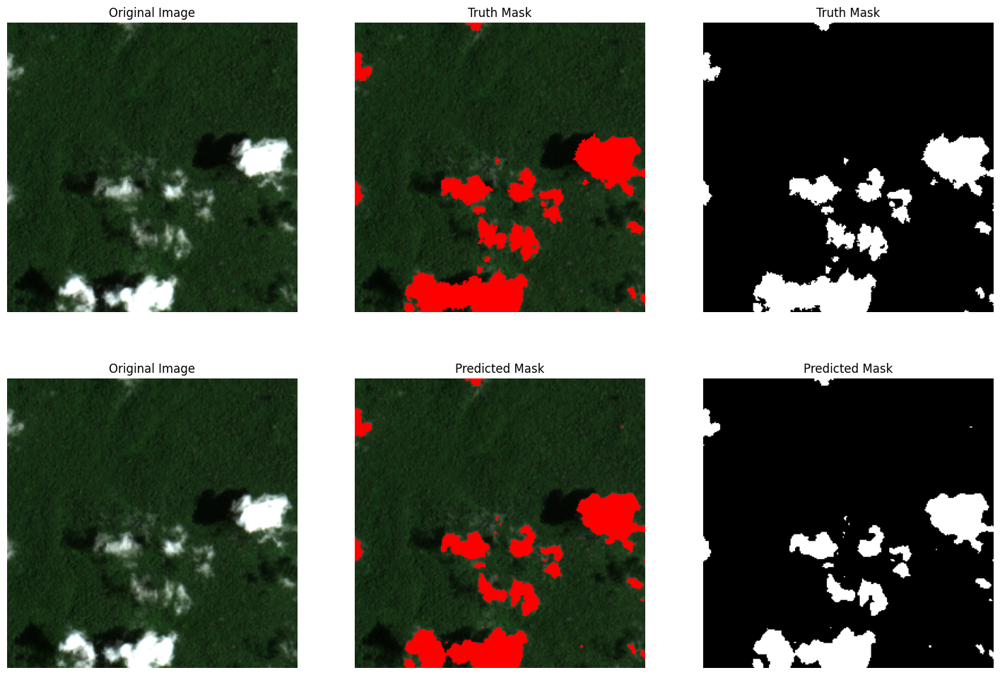

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200818T142741_N0214_R053_T20LMP_20200818T165705_11_08_tile256_1_0.tif


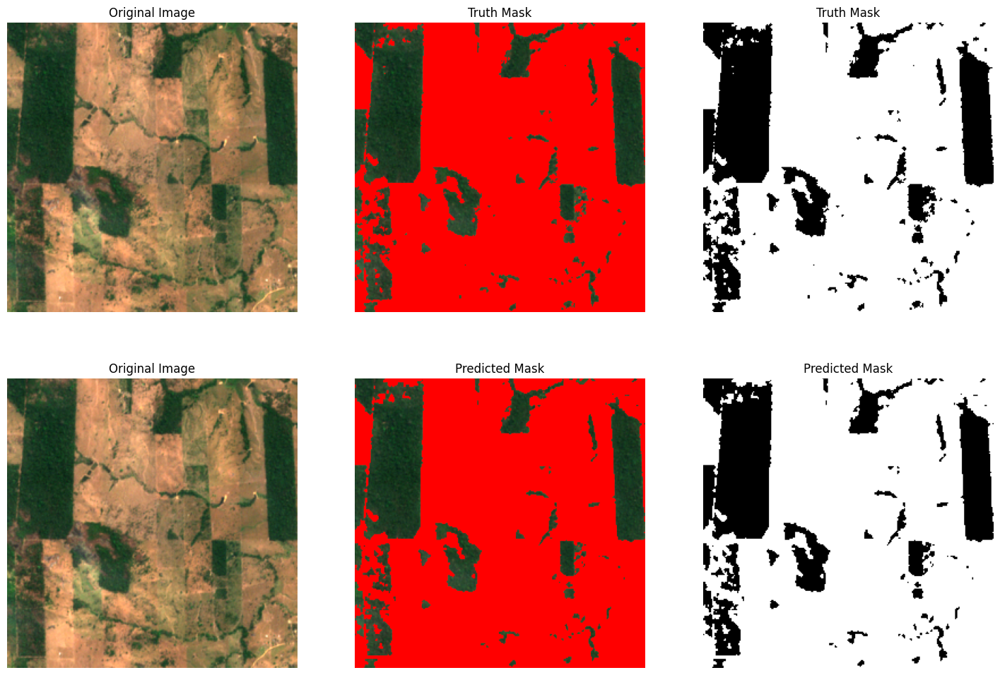

f: /content/drive/MyDrive/content/drive/GreenGuardians/AMAZON256/Test/images/S2A_MSIL2A_20200217T141651_N0209_R010_T20LQN_20200217T160045_16_14_tile256_0_0.tif


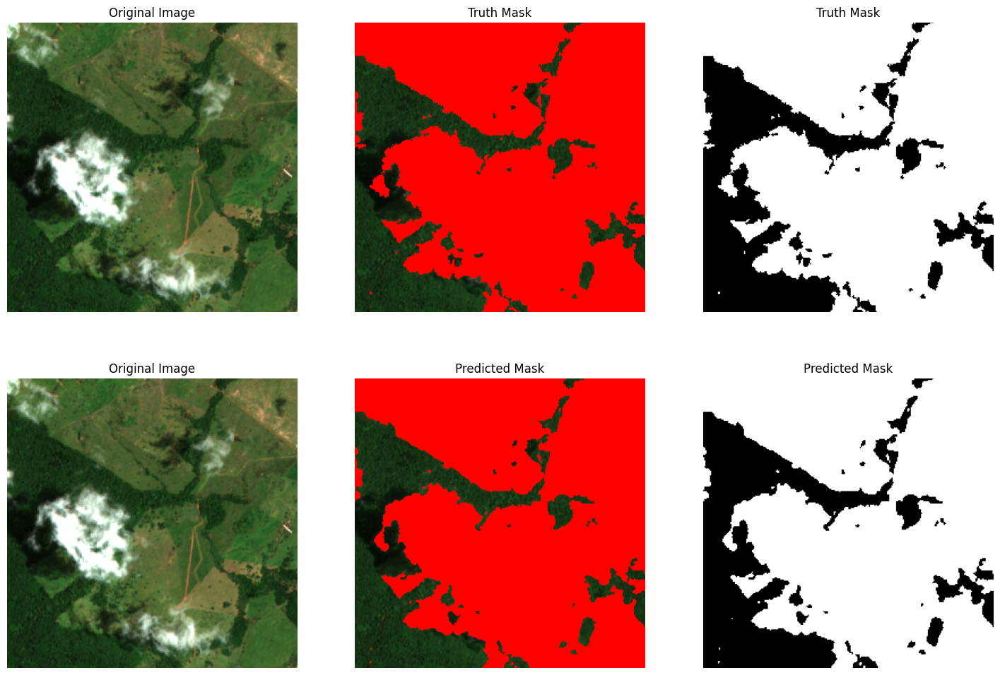

time: 27.3 s (started: 2023-07-27 23:31:34 +00:00)


In [ ]:
# import glob
# # import os

# list_of_files = glob.glob(model_path + '*') # * means all if need specific format then *.csv
# newest_model_checkpoint = max(list_of_files, key=os.path.getctime)
# print("Newest Model Checkpoint:", newest_model_checkpoint)

# # initialize model again
# device = torch.device( 'cuda' if torch.cuda.is_available() else 'cpu' )

# # load state from latest checkpoint
# model = torch.load(newest_model_checkpoint)


eval_model_with_dataset( model, test_data, test_loader )



##Model Output with Train Data

In [ ]:
model = torch.load(early_stopping.best_pt)

eval_model_with_dataset( model, train_data, train_loader )


##Model Output with Boreal Forest Data


In [ ]:
def eval_model_with_borealforest( model, dataset, dataset_loader ):

    trans = None

    t_data = dataset
    t_loader = dataset_loader


    model.eval()
    total_loss, total_dice, total_iou = 0.0, 0.0, 0.0
    for i, (images, target, _, i_f, m_f) in enumerate(t_loader):

        images = images.to(device)
        label_mask = target.numpy()[0][0]
        label_mask = label_mask.astype('float32')

        f = i_f[0]
        print("f:", f)

        with torch.no_grad():
            outputs = model(images)

        predict_mask = outputs[0][0]
        predict_mask = torch.sigmoid(predict_mask)
        predict_mask = torch.round(predict_mask)
        predict_mask = predict_mask.cpu().detach().numpy()


        fig, ax = plt.subplots(1, 3, figsize=(18, 12))
        img, xsize, ysize, nbands = loadTIFF(f, 10000)
        img_rgb = np.dstack((img[:,:,0], img[:,:,1], img[:,:,2])).astype(np.float32)
        img_rgb = np.clip( img_rgb/2000, 0, 1)


        # # Create a red color overlay using the predict mask for deforestation
        # invert the mask as it predicts forestation.

        deforest_predict_mask = np.logical_not(predict_mask).astype(int)
        deforest_predict_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
        deforest_predict_overlay[..., 0] = .5 # Red channel ( since it is showing deforested  )
        deforest_predict_overlay[..., 3] = deforest_predict_mask


        # # Create a red color overlay using the labeled mask
        deforest_label_mask = label_mask
        deforest_label_overlay = np.zeros((img_rgb.shape[0], img_rgb.shape[1], 4))  # 4 for RGBA
        deforest_label_overlay[..., 2] = 1  # Blue channel ( showing scars )l
        deforest_label_overlay[..., 3] = deforest_label_mask

        # Display the original image and the ground truth masked image
        ax[0].imshow(img_rgb)
        ax[0].set_title('Original Image')
        ax[0].axis('off')

        ax[1].imshow(img_rgb)
        ax[1].imshow(deforest_predict_overlay)
        ax[1].set_title('Deforestation')
        ax[1].axis('off')

        ax[2].imshow(img_rgb)
        ax[2].imshow(deforest_label_overlay)
        ax[2].set_title(' Logging Scars')
        ax[2].axis('off')


        plt.show()


In [ ]:

# Loading boreal forest of Ontario dataset
boreal_data = ForestDataSet(data_type = 'none', forest='boreal')
boreal_loader = DataLoader(boreal_data, batch_size=1, shuffle=True)

/content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_caribou-lake-702_1.tif has 1024 NaN values.
/content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_caribou-lake-702_1.tif has 256 NaN values.
Boreal Forest n_pairs: 29
Mean: {'red': 0.039536912, 'green': 0.0460016, 'blue': 0.031633206, 'nir': 0.18118046, 'nvdi': 0.6191482}
Std Dev: {'red': 0.013311036, 'green': 0.01068894, 'blue': 0.0072314423, 'nir': 0.047421798, 'nvdi': 0.14689377}
Using 29/29 data files.
self.mean: [0.05809237 0.06499667 0.03907543 0.2980774  0.67502433]
self.SD: [0.04656493 0.03191178 0.0280921  0.07890162 0.23065257]
time: 1.1 s (started: 2023-07-27 23:28:35 +00:00)


<ipython-input-83-24a4f2ed6f19>:174: RuntimeWarning: invalid value encountered in true_divide
  nvdi = ( image[3] - image[0] ) / ( image[3] + image[0] )


Amazon: original pairs: 400
Atlantic: original pairs: 400
Total: original pairs: 800
Mean: {'red': 0.057409223, 'green': 0.06472079, 'blue': 0.038716096, 'nir': 0.29959354}
Std Dev: {'red': 0.045892097, 'green': 0.031139867, 'blue': 0.027061649, 'nir': 0.07877214}
Using 796/800 data files.
time: 6min 12s (started: 2023-07-18 17:20:53 +00:00)

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_hwy6424XX_1.tif


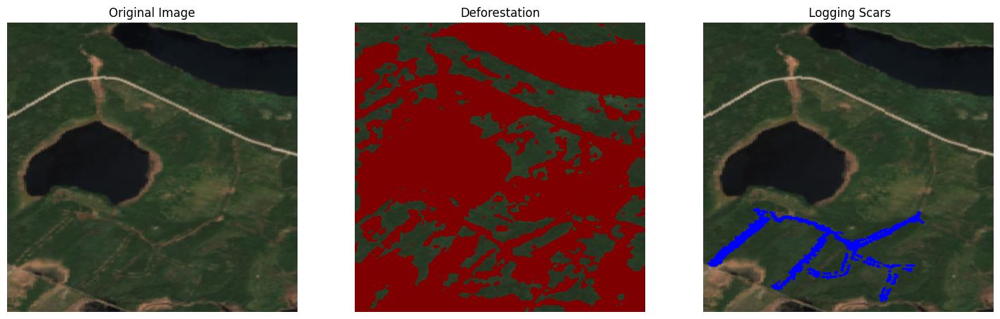

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_watin402_1.tif


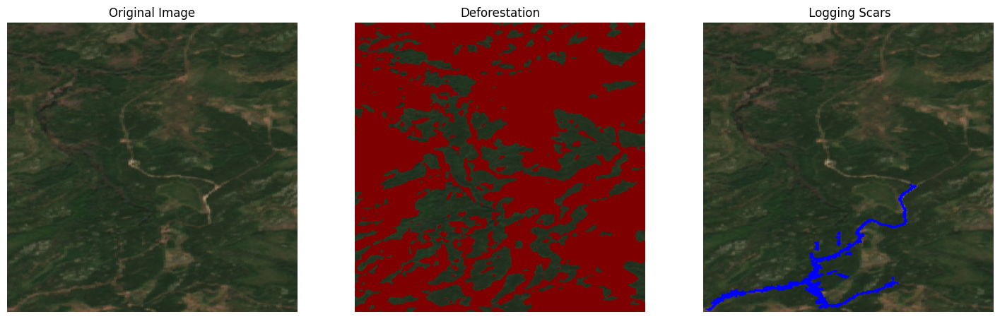

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_hillside360_1.tif


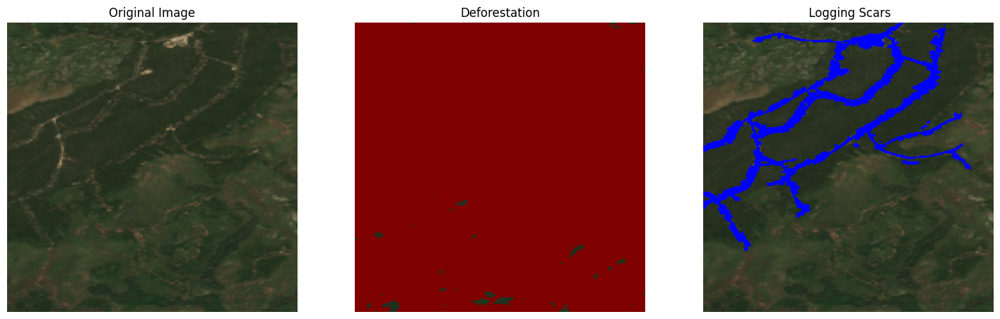

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_lacseul010.tif


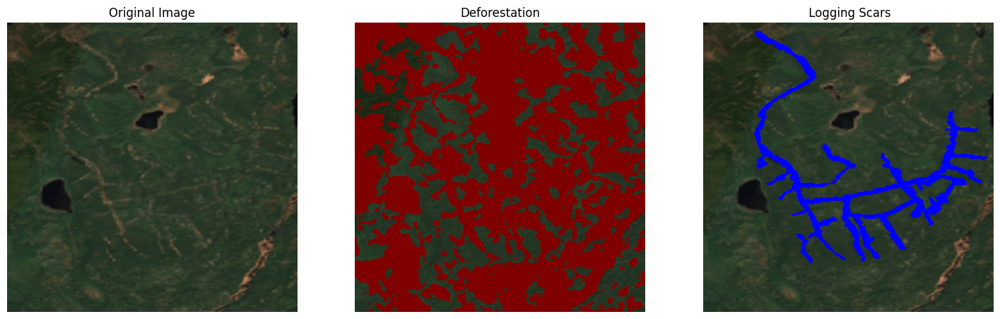

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_caribou-lake-710_1.tif


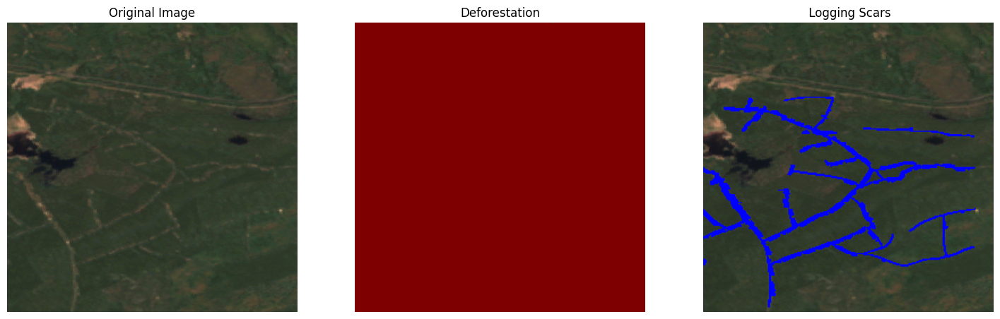

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_Whitesand-804_1.tif


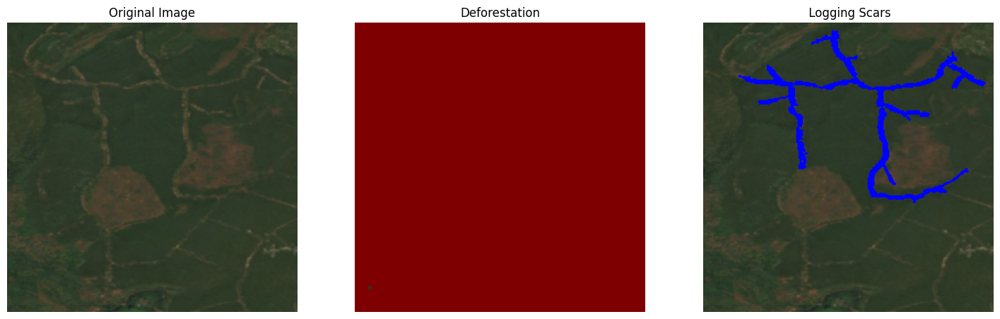

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_trist-109.tif


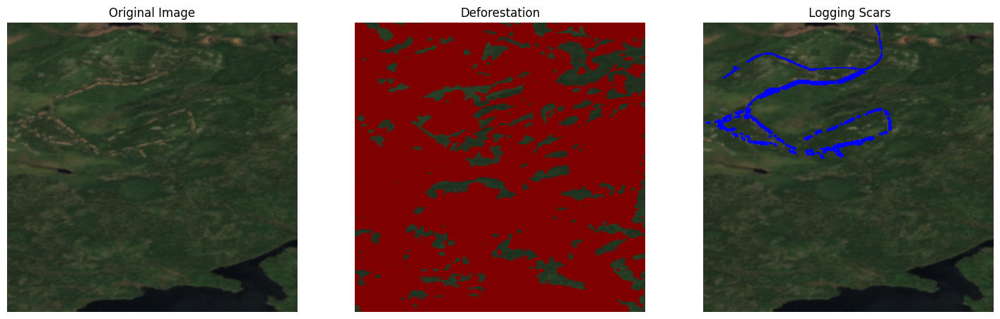

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_hillside360_3.tif


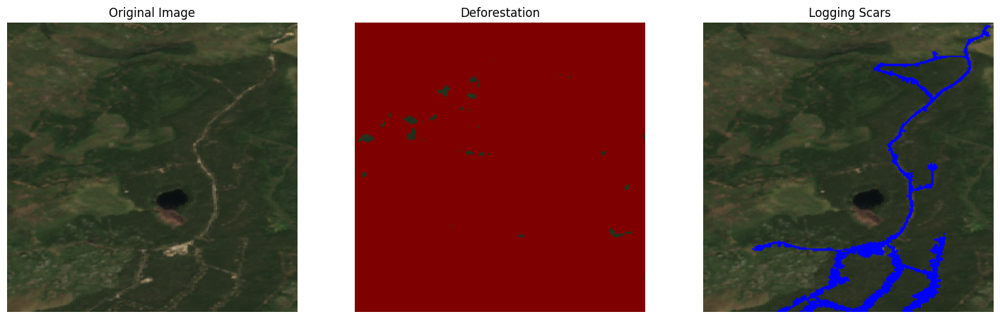

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_gibson-501.tif


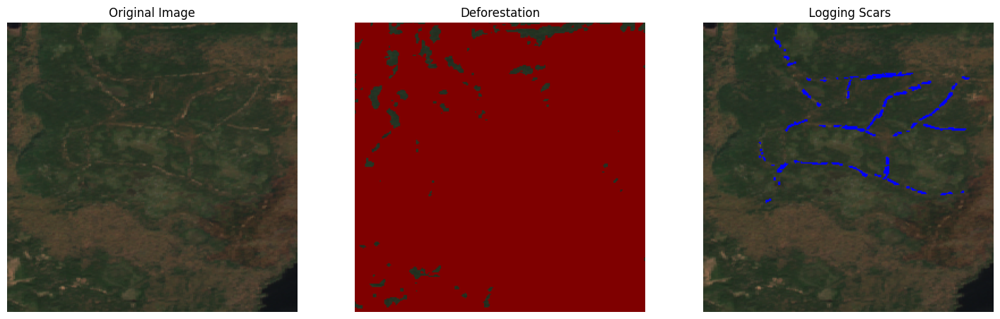

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_hwy6424XX_2.tif


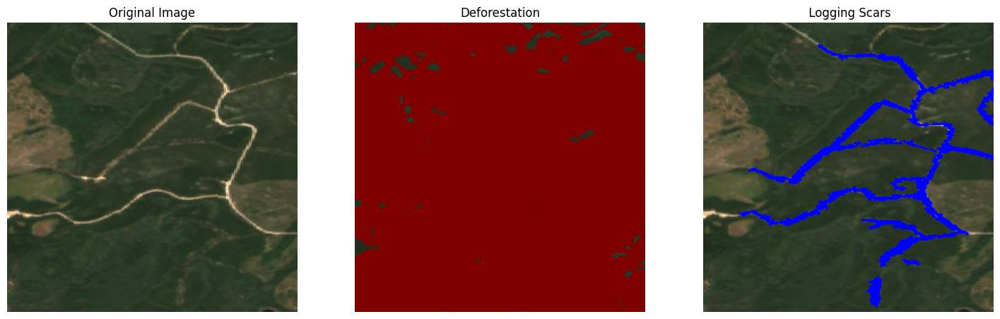

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_watin401_1.tif


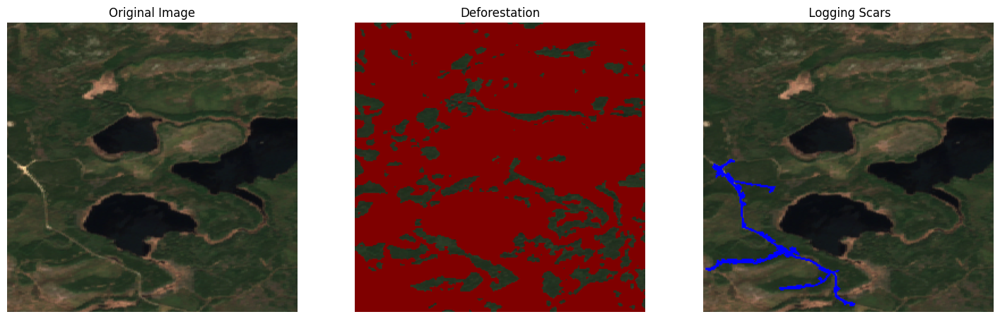

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_caribou-lake-701_1.tif


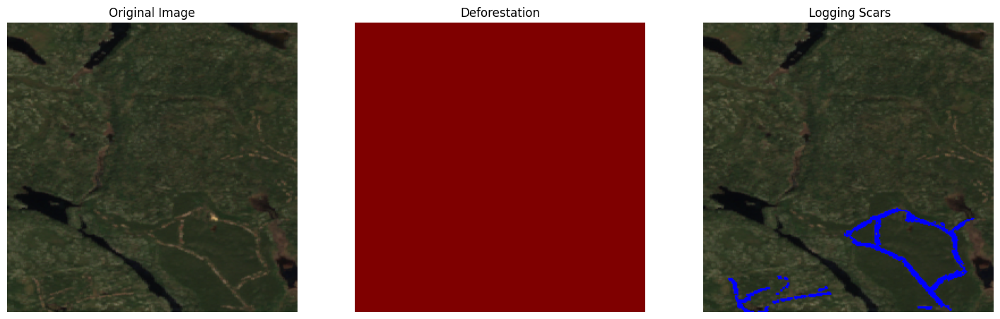

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_hillside360_4.tif


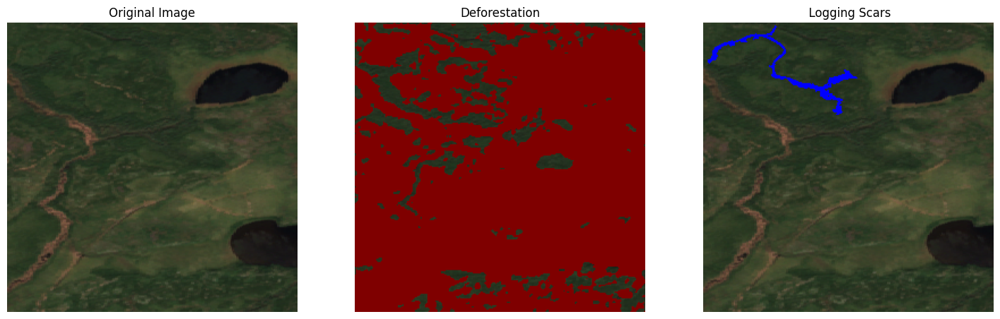

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_caribou-lake-710_2.tif


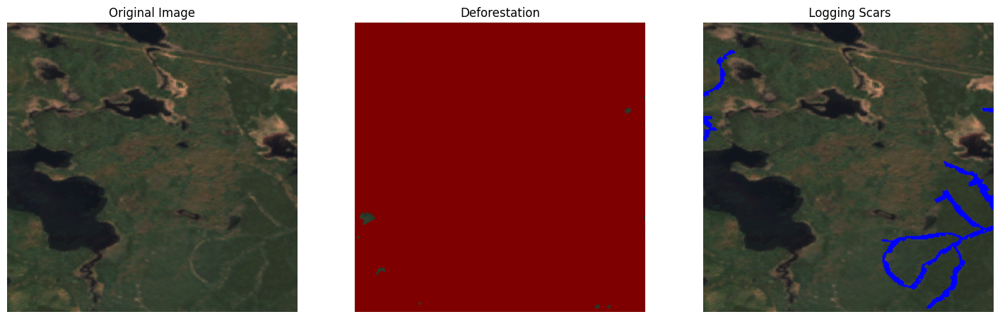

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_trist101.tif


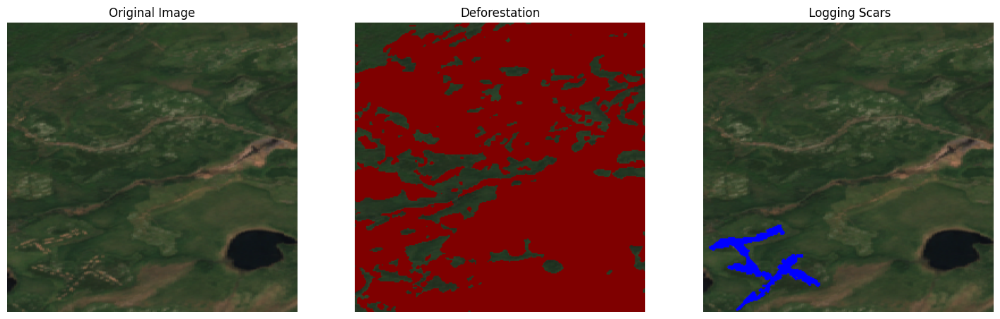

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_keershaw-504_1.tif


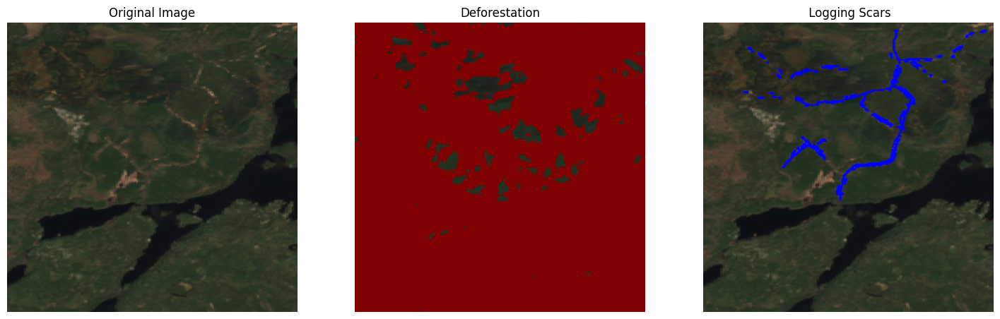

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_hillside360_2.tif


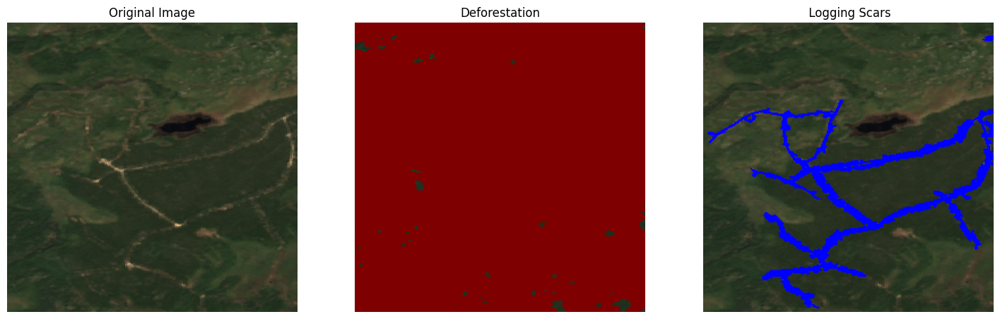

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_caribou-lake-708_1.tif


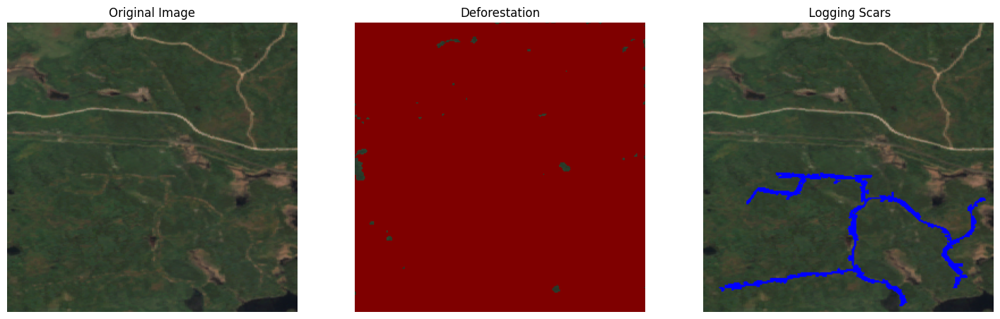

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_whitesand-805b_1.tif


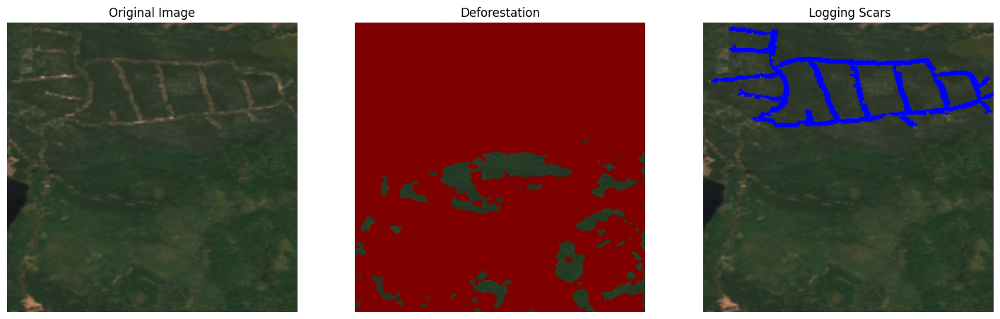

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_gibson-502_1.tif


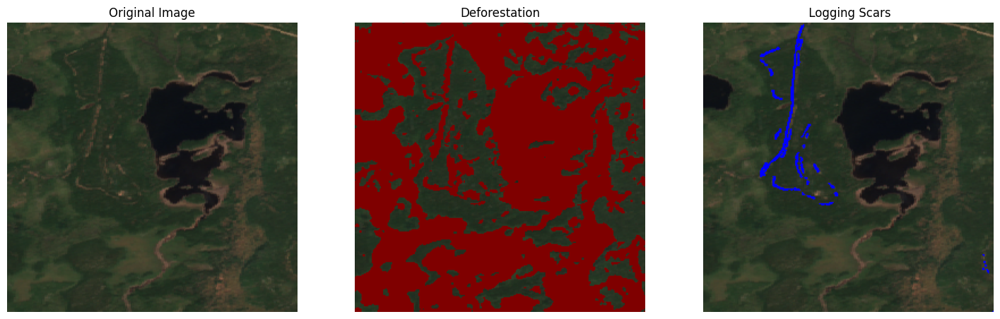

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_keershaw-503_1.tif


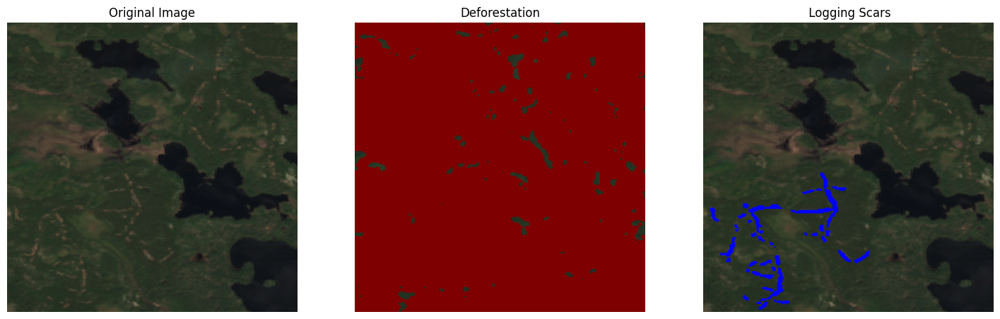

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_Whitesand-805a_1.tif


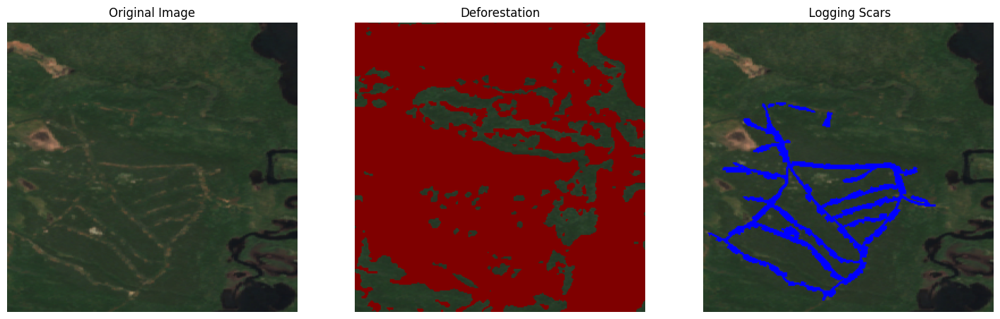

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_obonga-605.tif


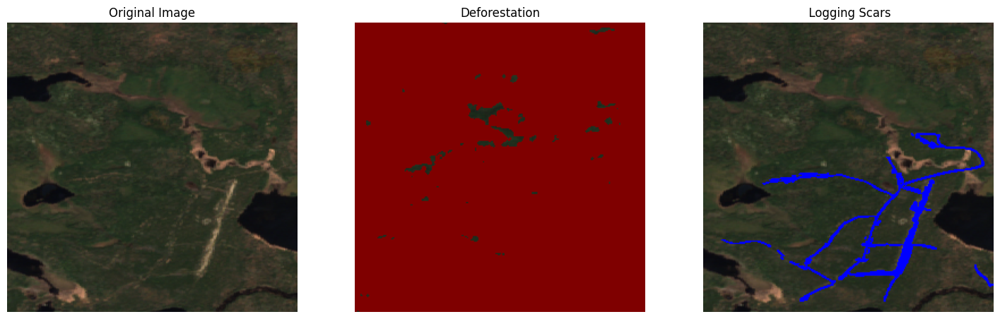

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_trist114_1.tif


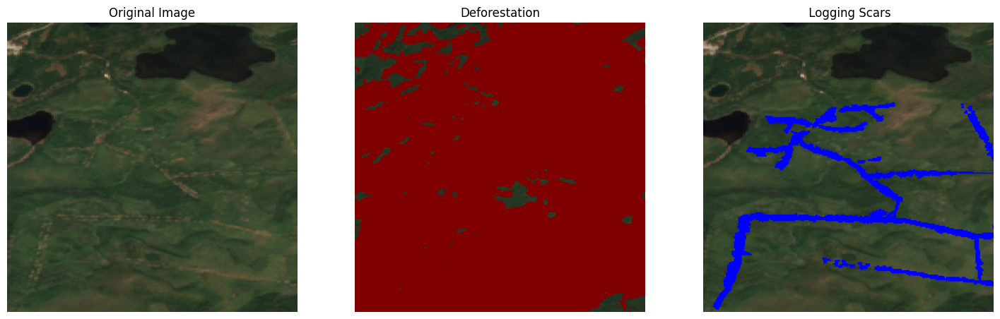

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_hwy6424XX_3.tif


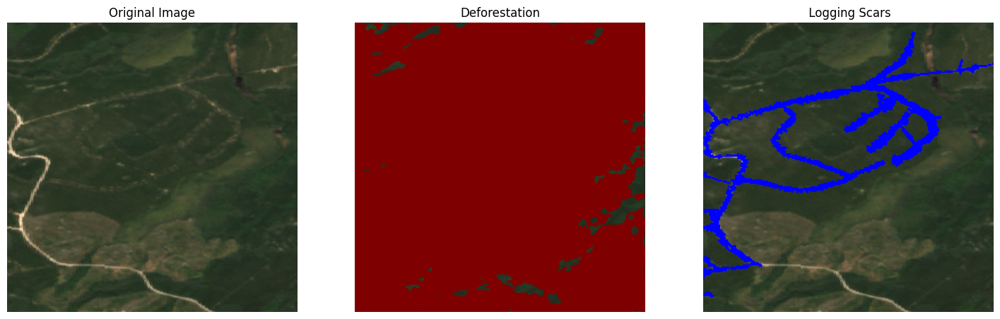

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_trist114_2.tif


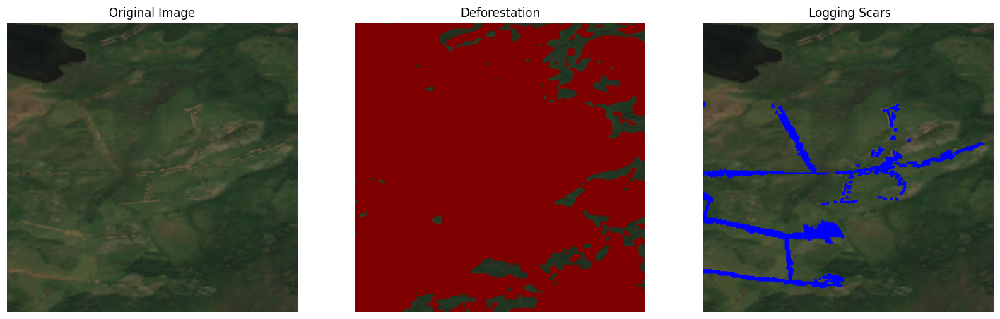

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_caribou-lake-702_1.tif


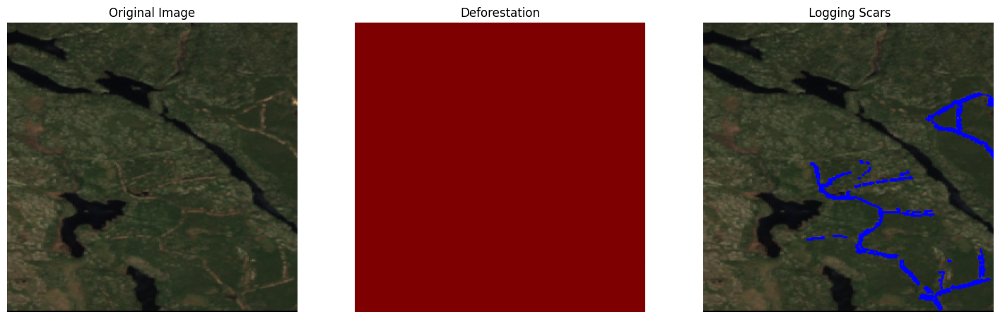

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_kiwi201_1.tif


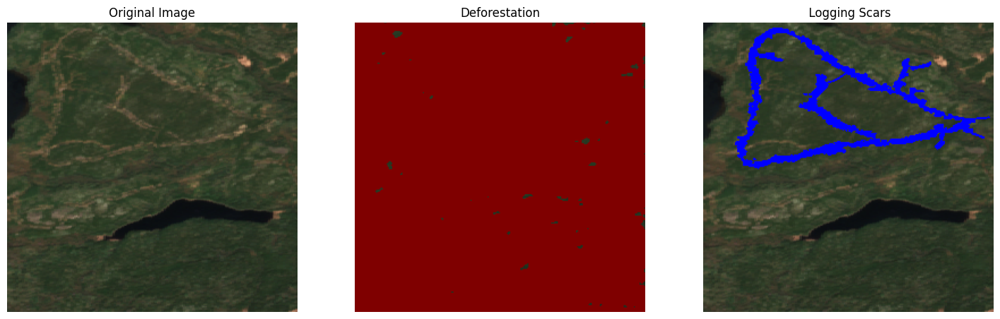

f: /content/drive/MyDrive/content/drive/GreenGuardians/BOREAL256/images/scars_trist130_1.tif


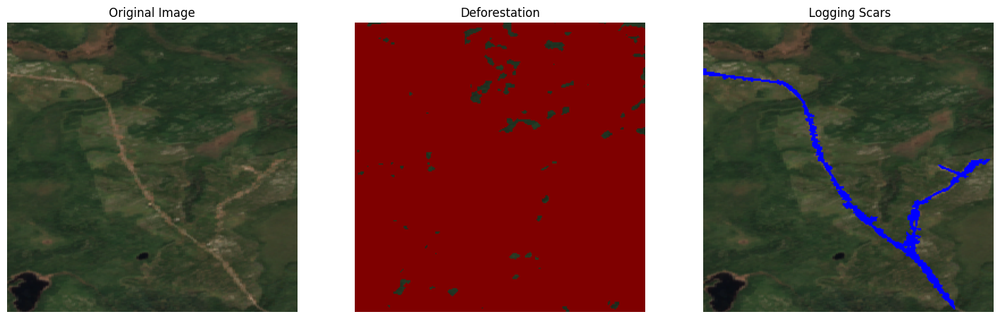

time: 17 s (started: 2023-07-27 23:28:53 +00:00)


In [ ]:
# import glob
# # import os

# list_of_files = glob.glob(model_path + '*') # * means all if need specific format then *.csv
# newest_model_checkpoint = max(list_of_files, key=os.path.getctime)
# print("Newest Model Checkpoint:", newest_model_checkpoint)

# # initialize model again
# device = torch.device( 'cuda' if torch.cuda.is_available() else 'cpu' )

# # load state from latest checkpoint
# model = torch.load(newest_model_checkpoint)

eval_model_with_borealforest( model, boreal_data, boreal_loader )